In [2]:
import IPython.display as ipd
import numpy as np
import pandas as pd
import librosa
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
from librosa import display
import os
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")


In [11]:
#For virtal wsl
#root_location = '/mnt/c/'
#ground_location = root_location + 'ESC-50-master/ESC-50-master/'

#For anaconda
ground_location =  'ESC-50-master/'
csv_file=ground_location+'meta/'

In [12]:
df = pd.read_csv(csv_file+'esc50.csv')
labels = list(df['category'].unique())

In [13]:
df.head(10)

,filename,fold,target,category,esc10,src_file,take
0,1-100032-A-0.wav,1,0,dog,True,100032,A
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A
5,1-101296-B-19.wav,1,19,thunderstorm,False,101296,B
6,1-101336-A-30.wav,1,30,door_wood_knock,False,101336,A
7,1-101404-A-34.wav,1,34,can_opening,False,101404,A
8,1-103298-A-9.wav,1,9,crow,False,103298,A
9,1-103995-A-30.wav,1,30,door_wood_knock,False,103995,A


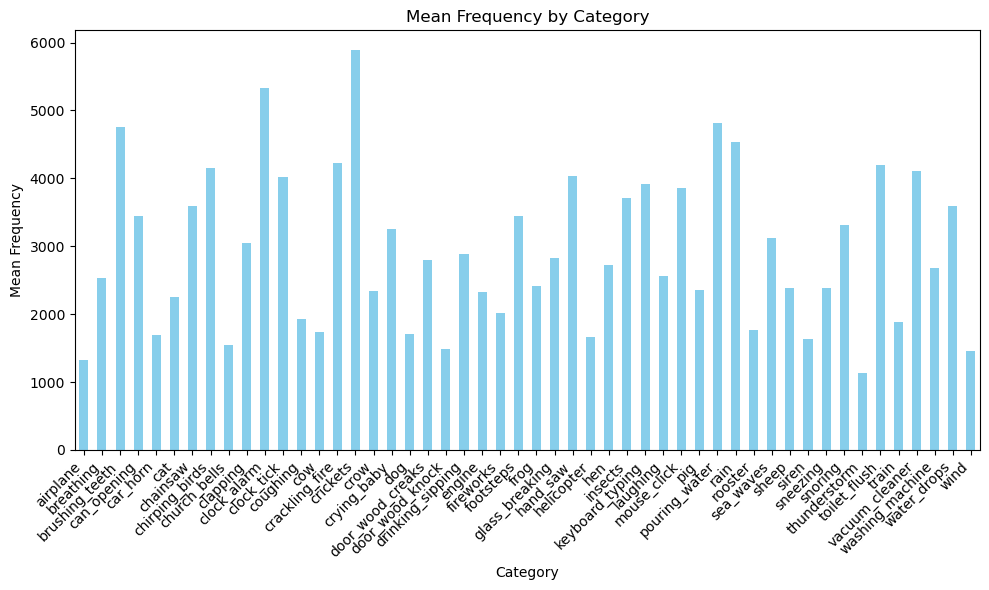

In [14]:
import pandas as pd
import librosa
import numpy as np
import matplotlib.pyplot as plt

audio_path = ground_location + 'audio/'
# Define a function to compute the mean frequency of an audio file
def compute_mean_frequency(audio_path):
    audio, sr = librosa.load(audio_path, sr=None)
    spectrogram = np.abs(librosa.stft(audio))
    mean_frequency = np.mean(librosa.feature.spectral_centroid(S=spectrogram, sr=sr))
    return mean_frequency

# Compute the mean frequency for each audio file
df['mean_frequency'] = df['filename'].apply(lambda x: compute_mean_frequency(audio_path + x))

# Group by category and calculate the mean frequency for each category
mean_frequency_by_category = df.groupby('category')['mean_frequency'].mean()

# Plot the mean frequency for each category
plt.figure(figsize=(10, 6))
mean_frequency_by_category.plot(kind='bar', color='skyblue')
plt.title('Mean Frequency by Category')
plt.xlabel('Category')
plt.ylabel('Mean Frequency')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


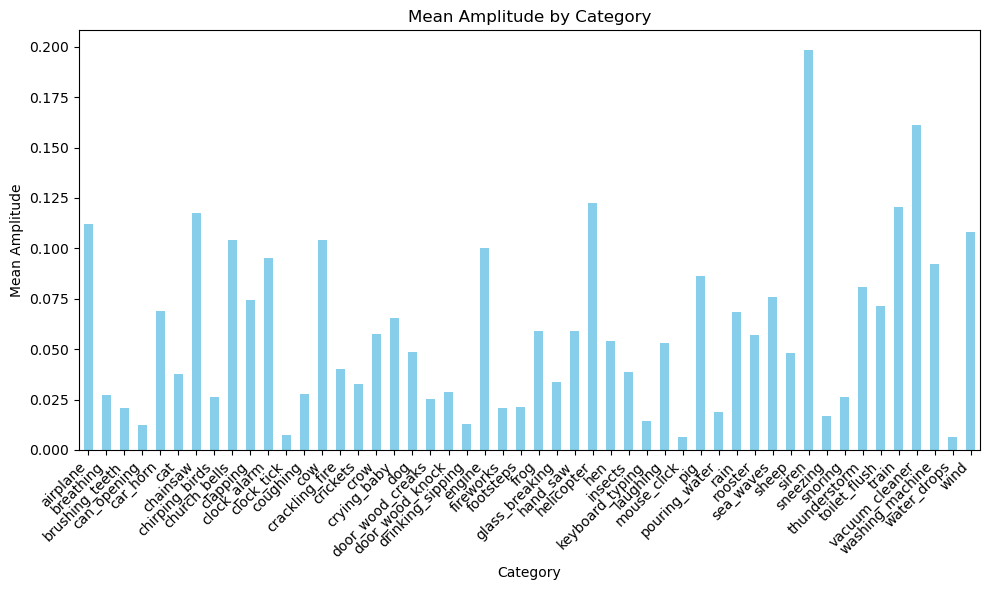

In [15]:
import pandas as pd
import librosa
import numpy as np
import matplotlib.pyplot as plt

audio_path = ground_location + 'audio/'
# Define a function to compute the mean amplitude of an audio file
def compute_mean_amplitude(audio_path):
    audio, sr = librosa.load(audio_path, sr=None)
    mean_amplitude = np.mean(np.abs(audio))
    return mean_amplitude

# Compute the mean amplitude for each audio file
df['mean_amplitude'] = df['filename'].apply(lambda x: compute_mean_amplitude(audio_path + x))

# Group by category and calculate the mean amplitude for each category
mean_amplitude_by_category = df.groupby('category')['mean_amplitude'].mean()

# Plot the mean amplitude for each category
plt.figure(figsize=(10, 6))
mean_amplitude_by_category.plot(kind='bar', color='skyblue')
plt.title('Mean Amplitude by Category')
plt.xlabel('Category')
plt.ylabel('Mean Amplitude')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [16]:
# Let's grab a single audio file from each class
files = dict()
for i in range(len(labels)):
    tmp = df[df['category'] == labels[i]][:1].reset_index()
    path = ground_location+'audio/{}'.format(tmp['filename'][0])
    files[labels[i]] = path

In [17]:
from IPython.display import display, Audio

# play the files containing paths to audio files
for label, path in files.items():
    print(f"Playing audio for label: {label}")
    display(Audio(filename=path))


Playing audio for label: dog


Playing audio for label: chirping_birds


Playing audio for label: vacuum_cleaner


Playing audio for label: thunderstorm


Playing audio for label: door_wood_knock


Playing audio for label: can_opening


Playing audio for label: crow


Playing audio for label: clapping


Playing audio for label: fireworks


Playing audio for label: chainsaw


Playing audio for label: airplane


Playing audio for label: mouse_click


Playing audio for label: pouring_water


Playing audio for label: train


Playing audio for label: sheep


Playing audio for label: water_drops


Playing audio for label: church_bells


Playing audio for label: clock_alarm


Playing audio for label: keyboard_typing


Playing audio for label: wind


Playing audio for label: footsteps


Playing audio for label: frog


Playing audio for label: cow


Playing audio for label: brushing_teeth


Playing audio for label: car_horn


Playing audio for label: crackling_fire


Playing audio for label: helicopter


Playing audio for label: drinking_sipping


Playing audio for label: rain


Playing audio for label: insects


Playing audio for label: laughing


Playing audio for label: hen


Playing audio for label: engine


Playing audio for label: breathing


Playing audio for label: crying_baby


Playing audio for label: hand_saw


Playing audio for label: coughing


Playing audio for label: glass_breaking


Playing audio for label: snoring


Playing audio for label: toilet_flush


Playing audio for label: pig


Playing audio for label: washing_machine


Playing audio for label: clock_tick


Playing audio for label: sneezing


Playing audio for label: rooster


Playing audio for label: sea_waves


Playing audio for label: siren


Playing audio for label: cat


Playing audio for label: door_wood_creaks


Playing audio for label: crickets


Plotting waveform for audio with label: dog


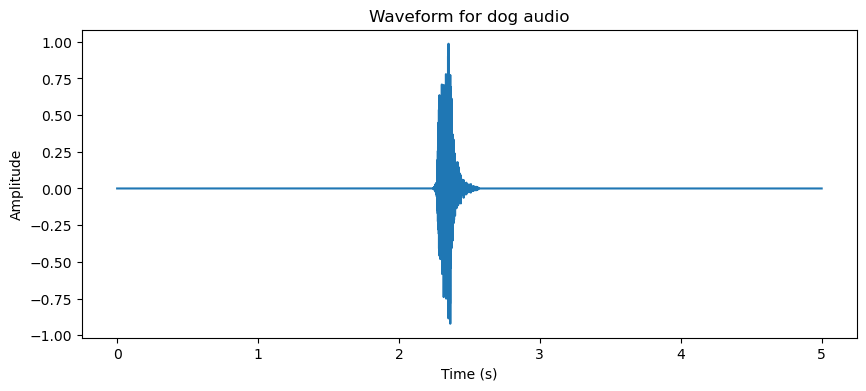

Plotting waveform for audio with label: chirping_birds


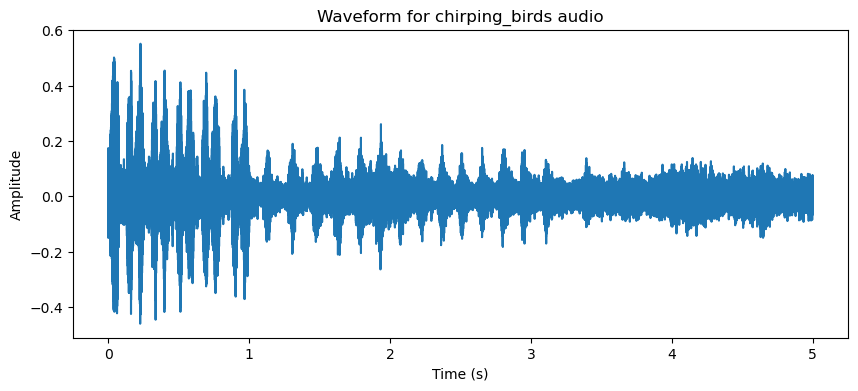

Plotting waveform for audio with label: vacuum_cleaner


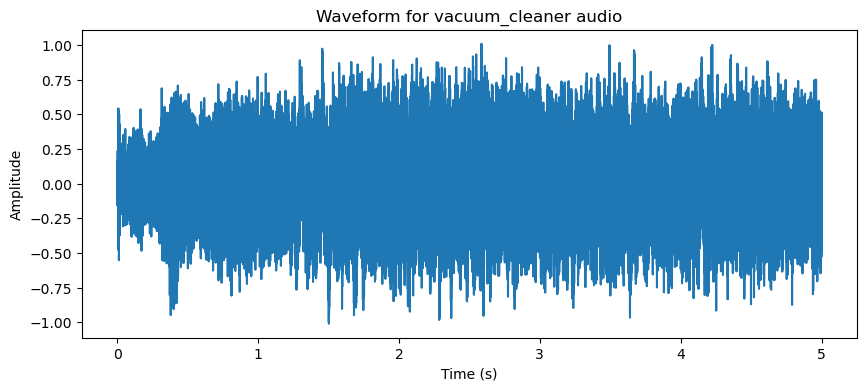

Plotting waveform for audio with label: thunderstorm


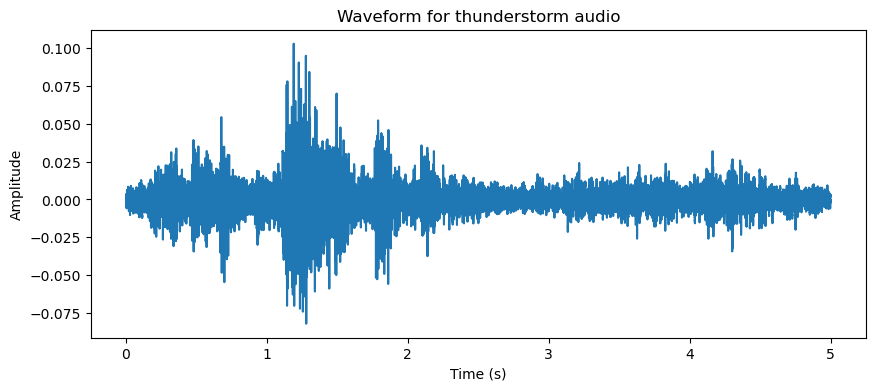

Plotting waveform for audio with label: door_wood_knock


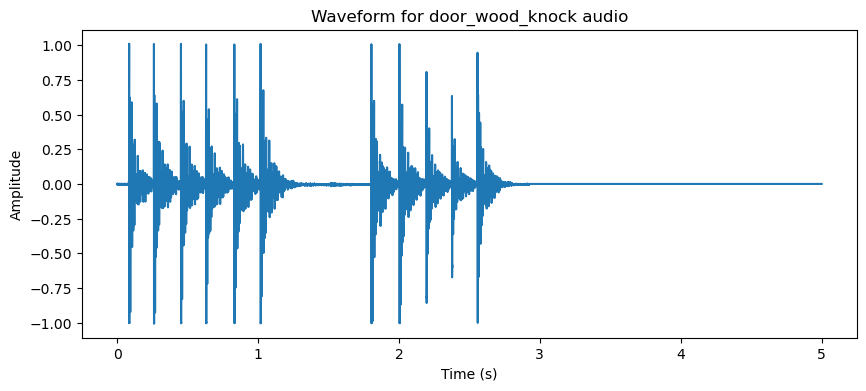

Plotting waveform for audio with label: can_opening


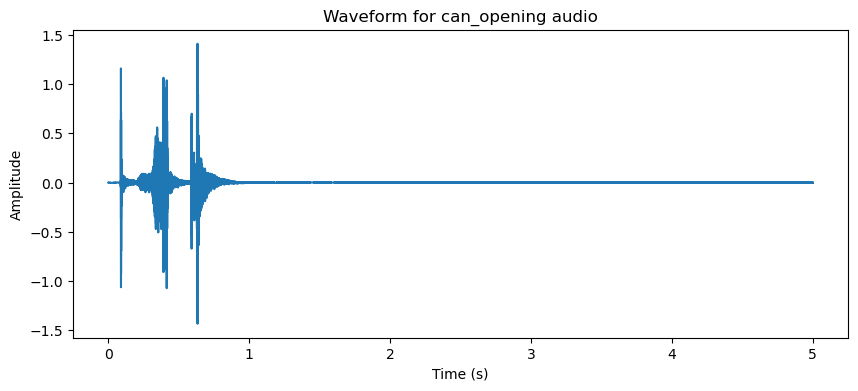

Plotting waveform for audio with label: crow


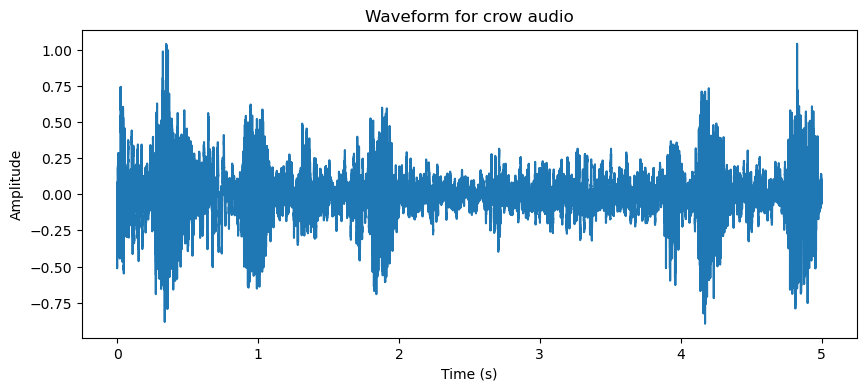

Plotting waveform for audio with label: clapping


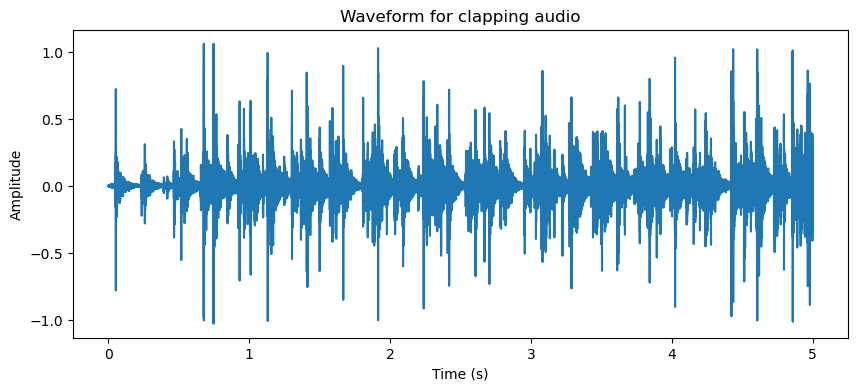

Plotting waveform for audio with label: fireworks


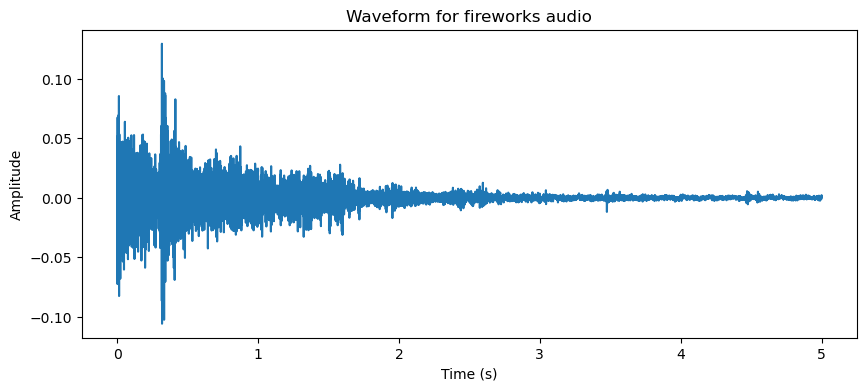

Plotting waveform for audio with label: chainsaw


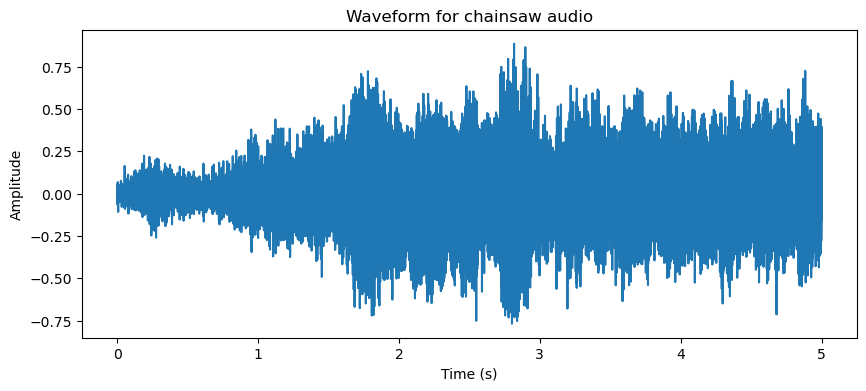

Plotting waveform for audio with label: airplane


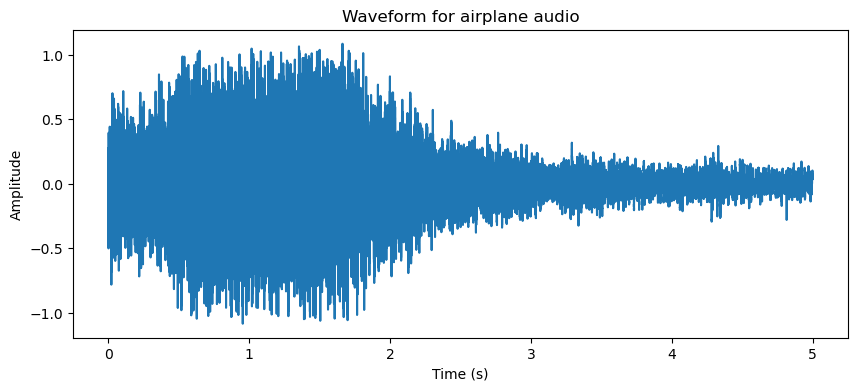

Plotting waveform for audio with label: mouse_click


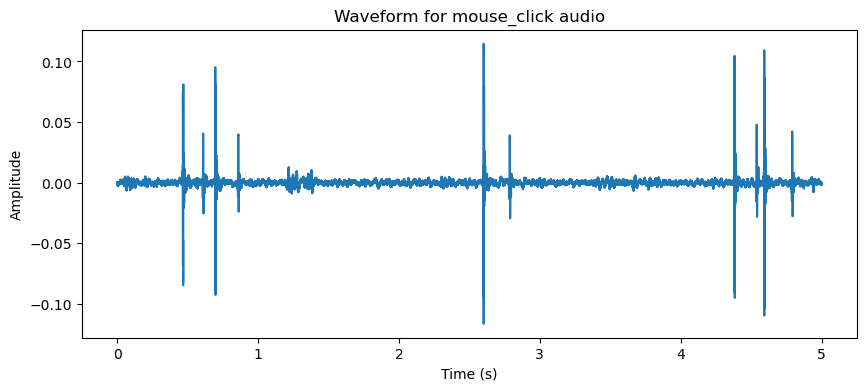

Plotting waveform for audio with label: pouring_water


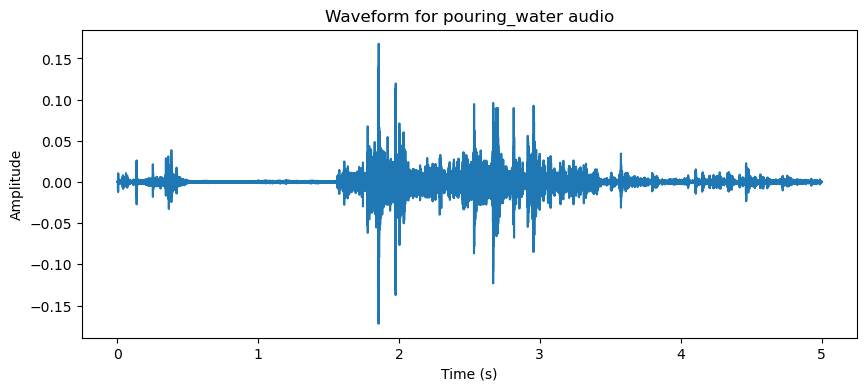

Plotting waveform for audio with label: train


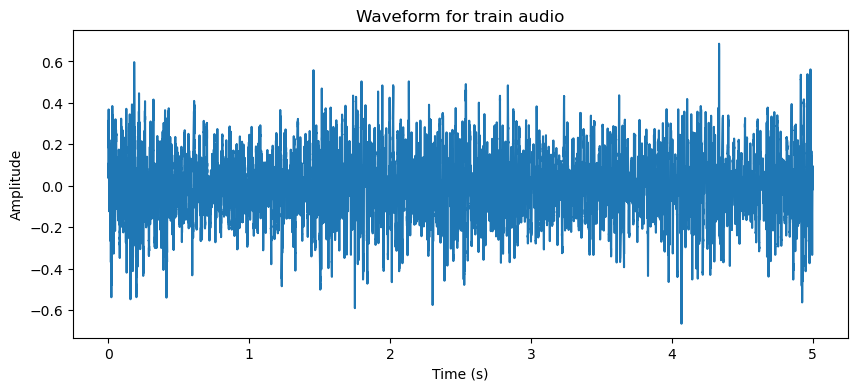

Plotting waveform for audio with label: sheep


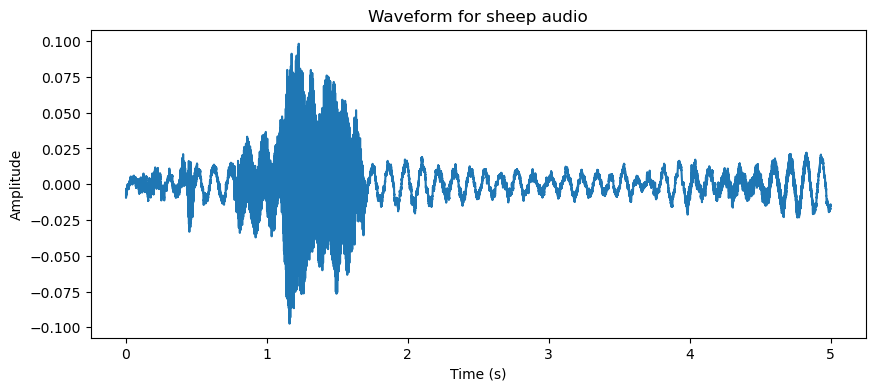

Plotting waveform for audio with label: water_drops


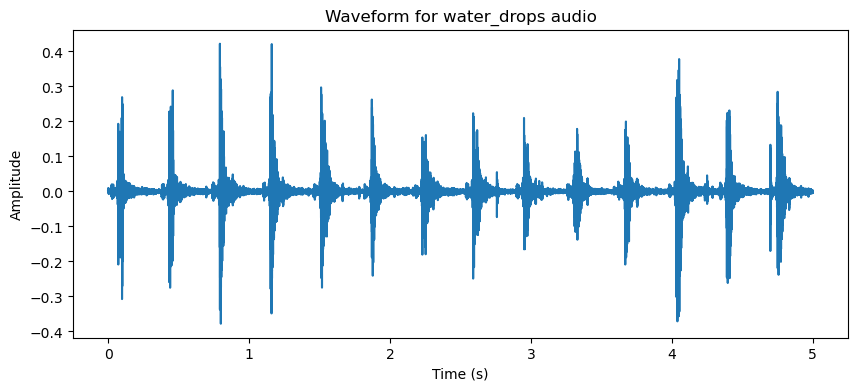

Plotting waveform for audio with label: church_bells


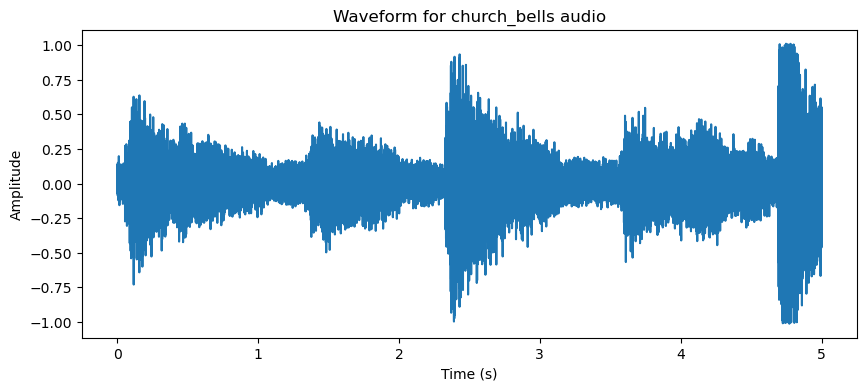

Plotting waveform for audio with label: clock_alarm


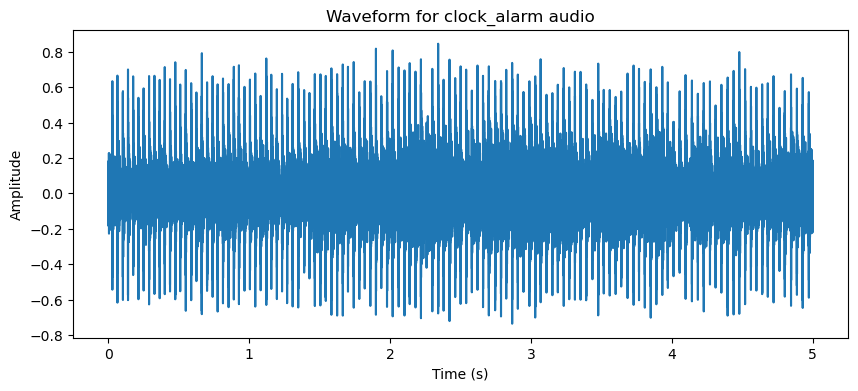

Plotting waveform for audio with label: keyboard_typing


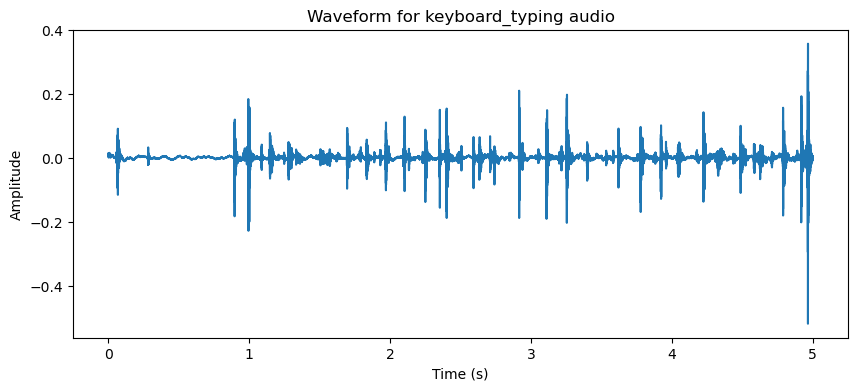

Plotting waveform for audio with label: wind


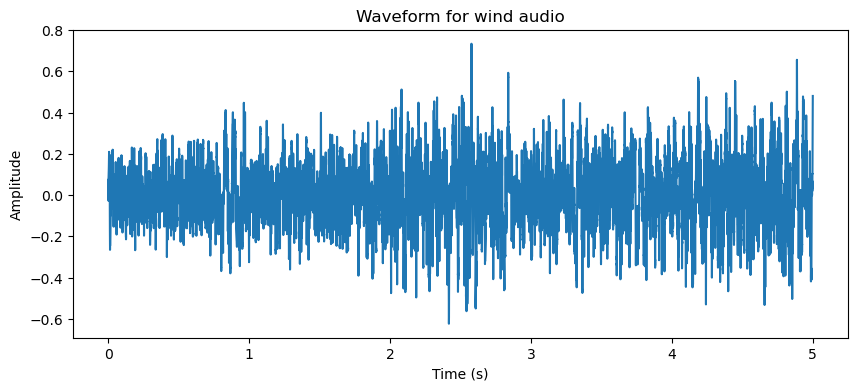

Plotting waveform for audio with label: footsteps


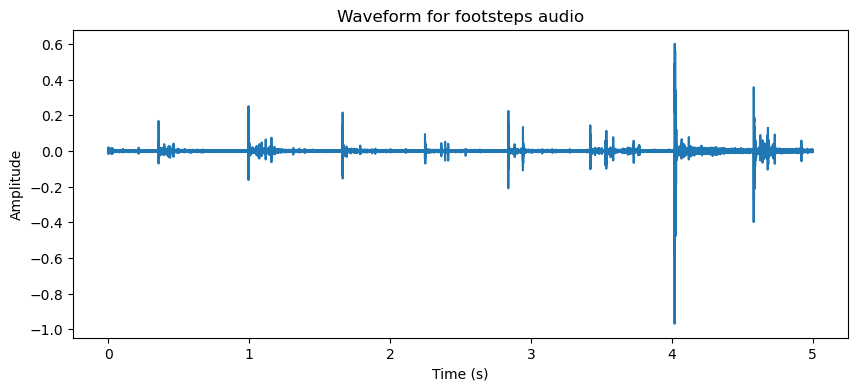

Plotting waveform for audio with label: frog


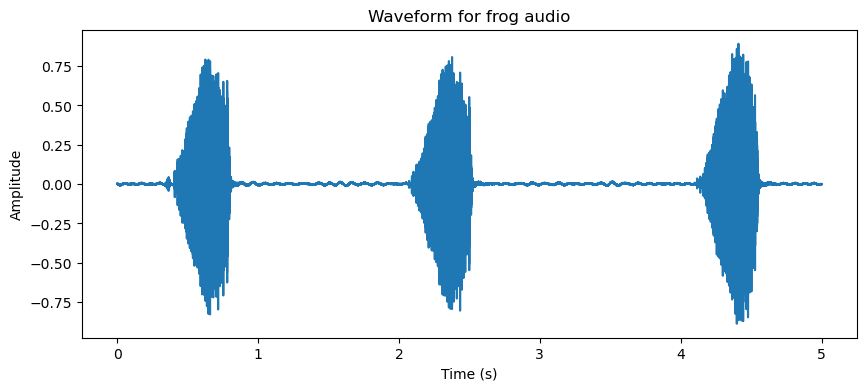

Plotting waveform for audio with label: cow


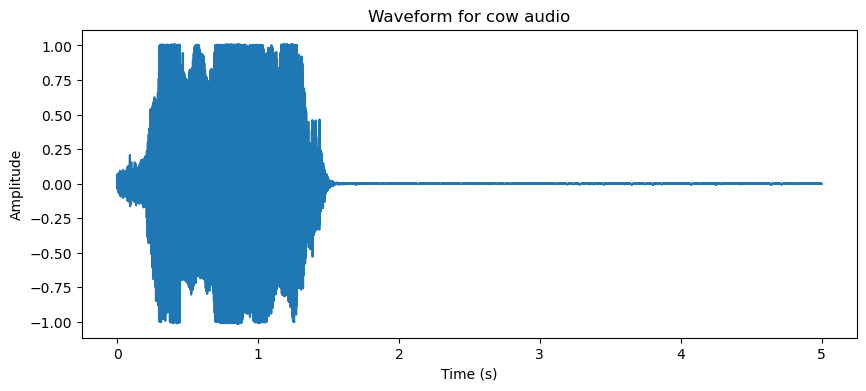

Plotting waveform for audio with label: brushing_teeth


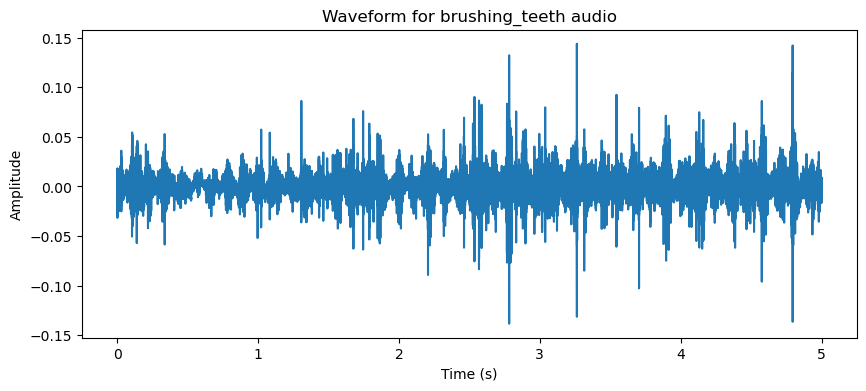

Plotting waveform for audio with label: car_horn


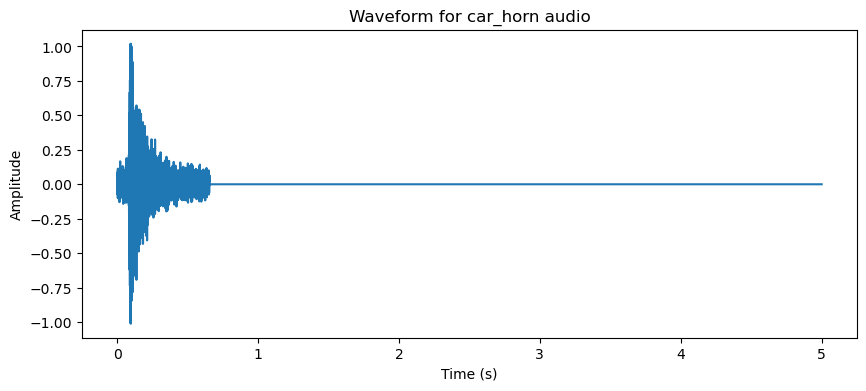

Plotting waveform for audio with label: crackling_fire


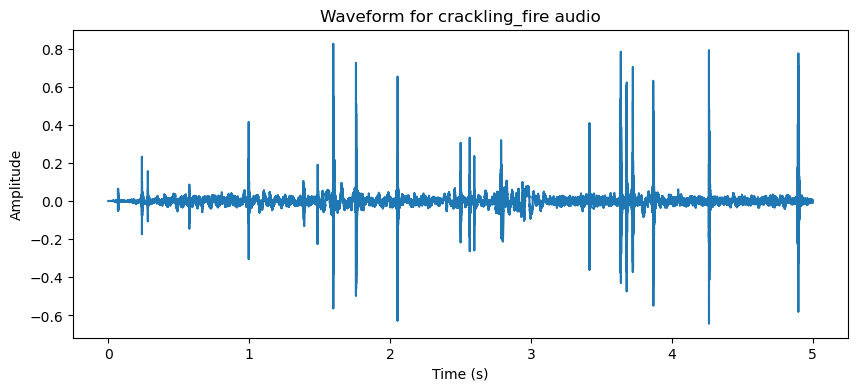

Plotting waveform for audio with label: helicopter


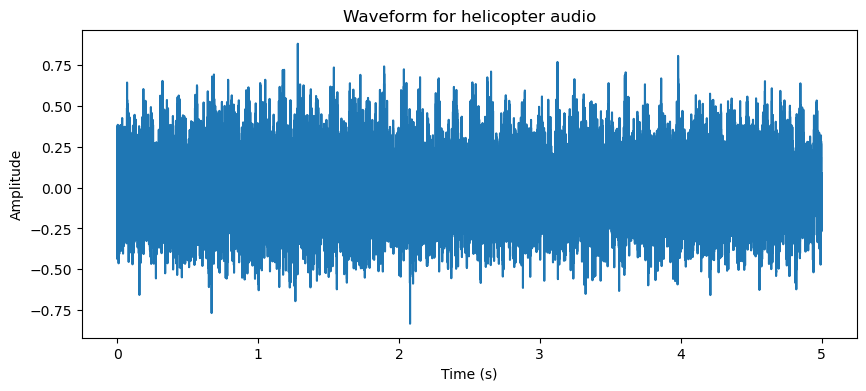

Plotting waveform for audio with label: drinking_sipping


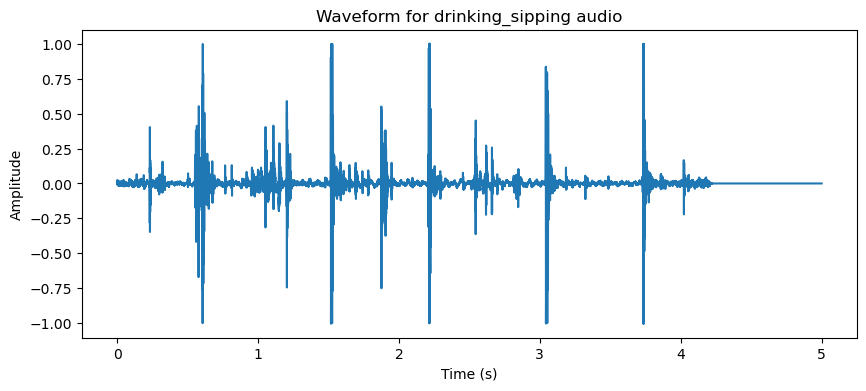

Plotting waveform for audio with label: rain


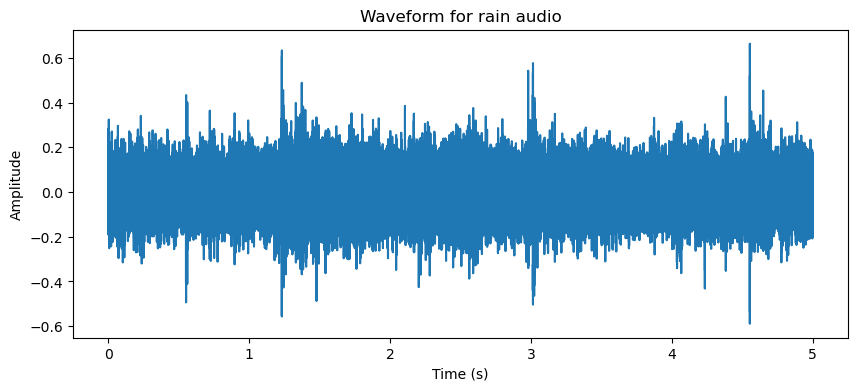

Plotting waveform for audio with label: insects


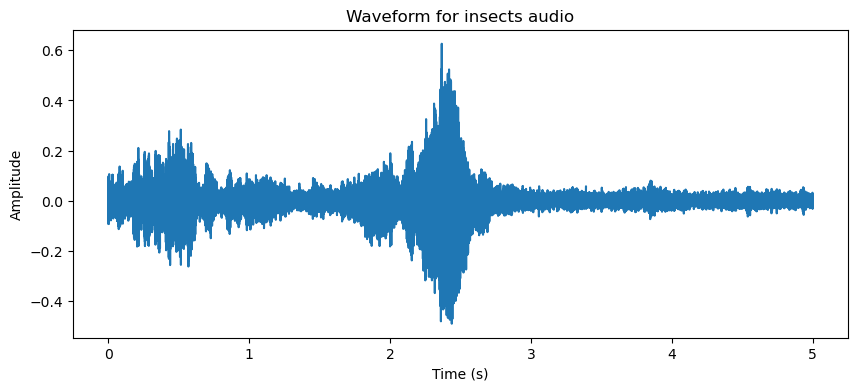

Plotting waveform for audio with label: laughing


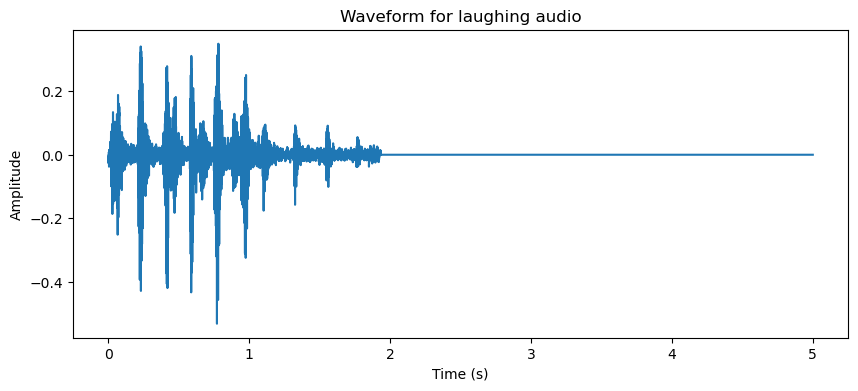

Plotting waveform for audio with label: hen


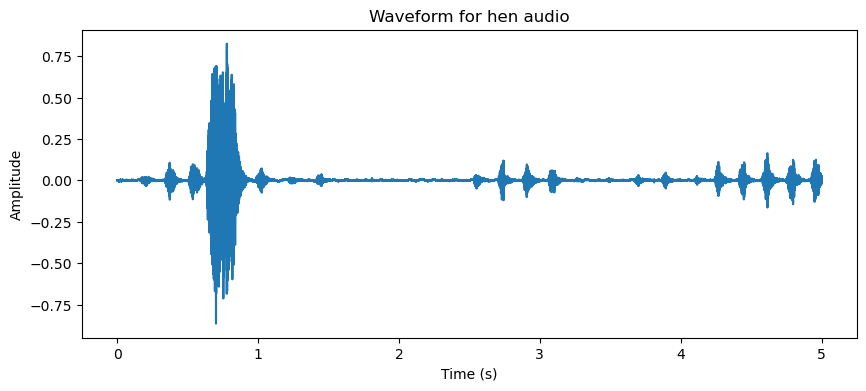

Plotting waveform for audio with label: engine


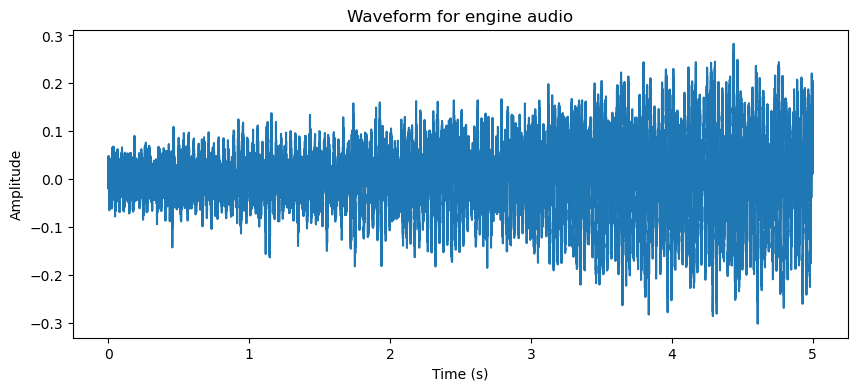

Plotting waveform for audio with label: breathing


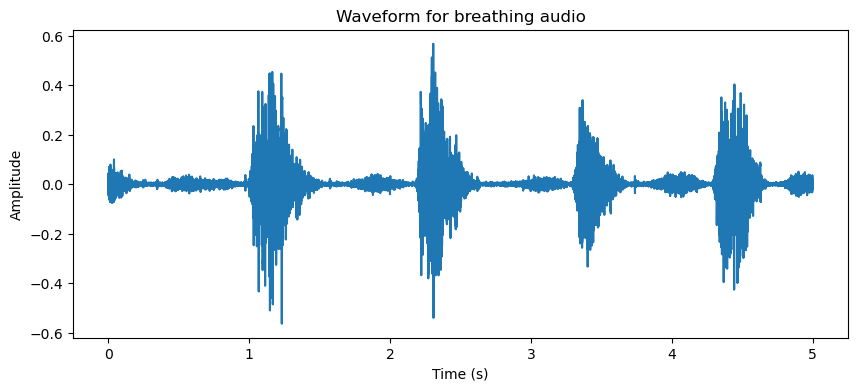

Plotting waveform for audio with label: crying_baby


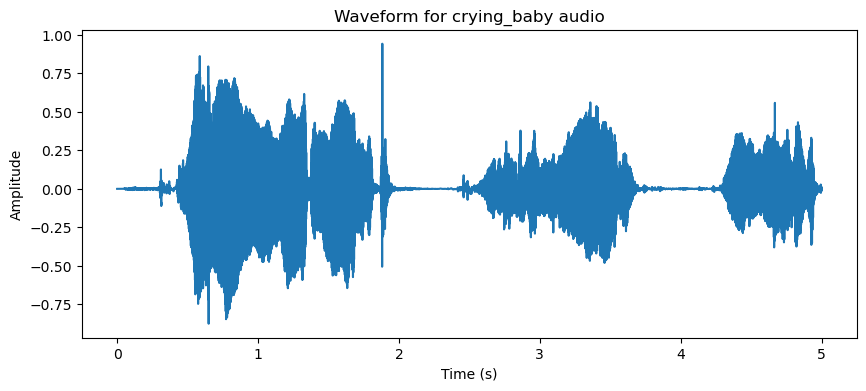

Plotting waveform for audio with label: hand_saw


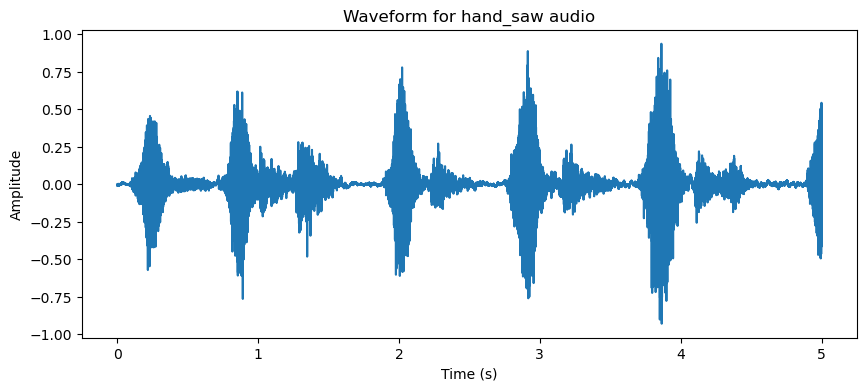

Plotting waveform for audio with label: coughing


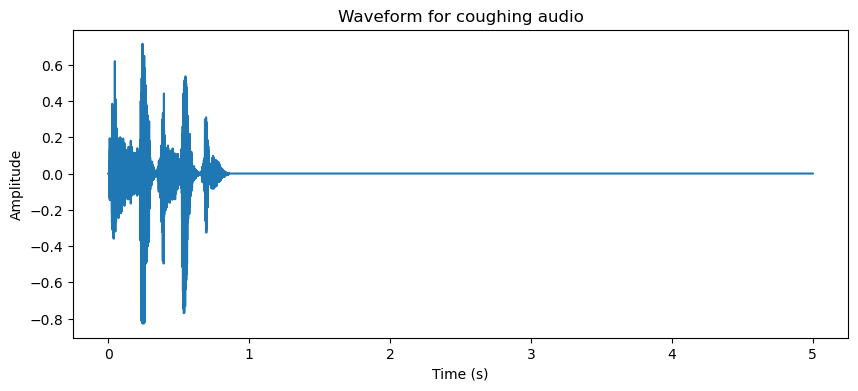

Plotting waveform for audio with label: glass_breaking


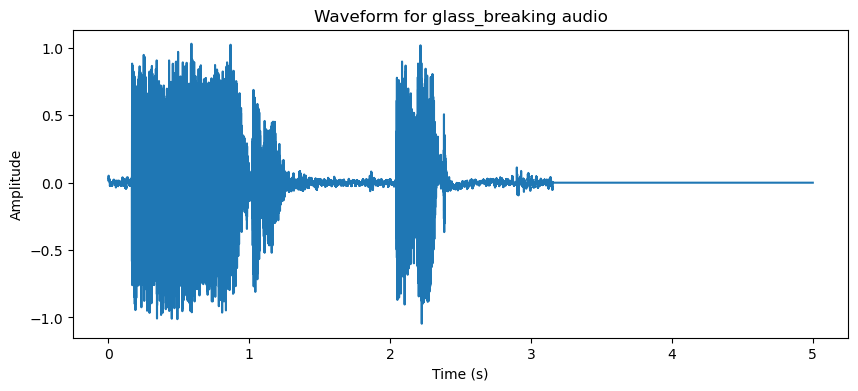

Plotting waveform for audio with label: snoring


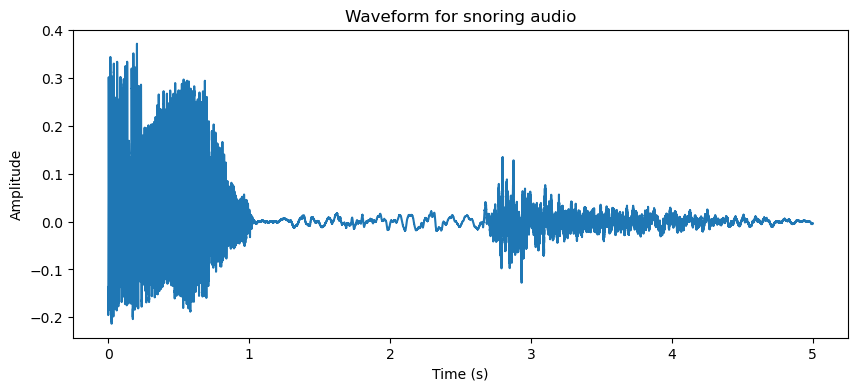

Plotting waveform for audio with label: toilet_flush


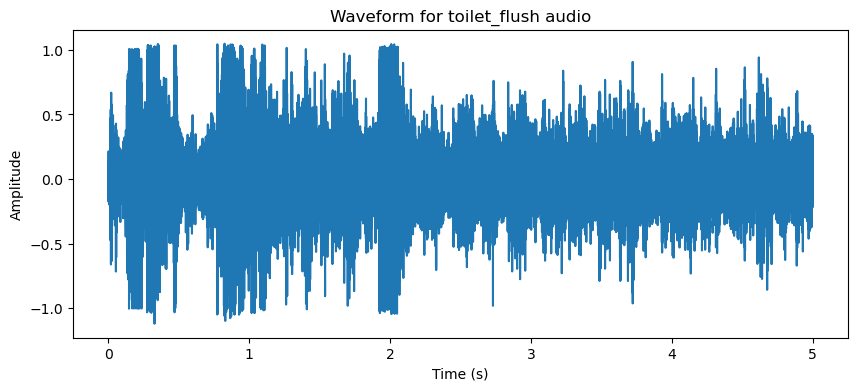

Plotting waveform for audio with label: pig


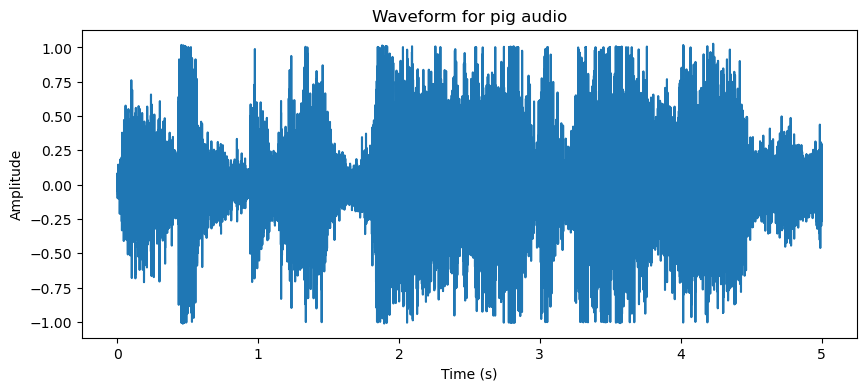

Plotting waveform for audio with label: washing_machine


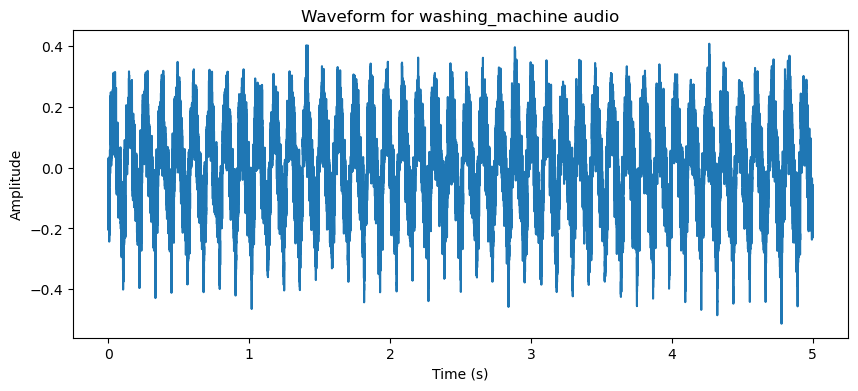

Plotting waveform for audio with label: clock_tick


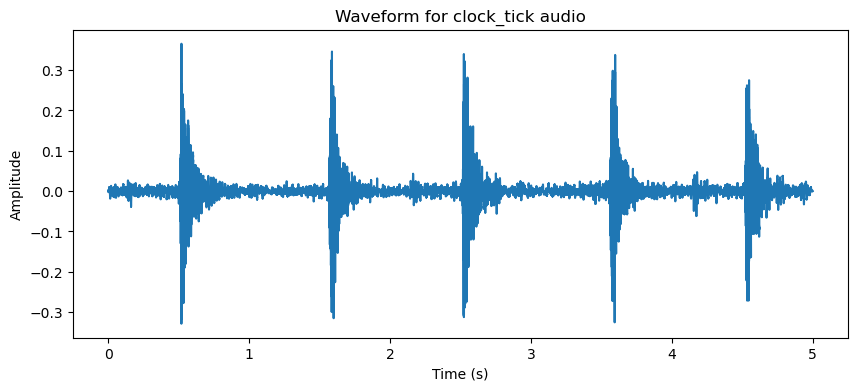

Plotting waveform for audio with label: sneezing


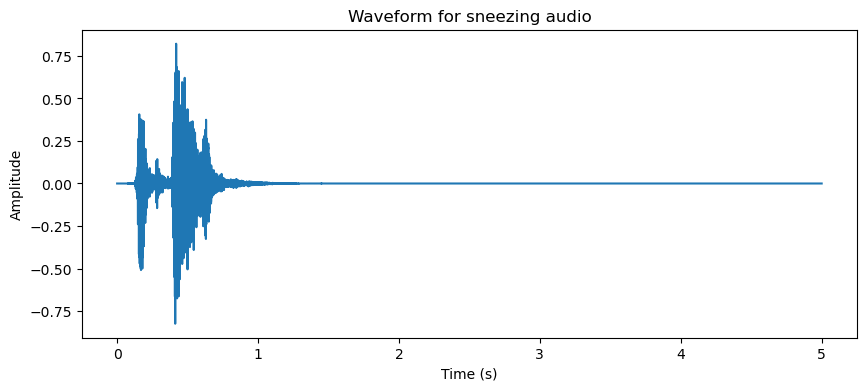

Plotting waveform for audio with label: rooster


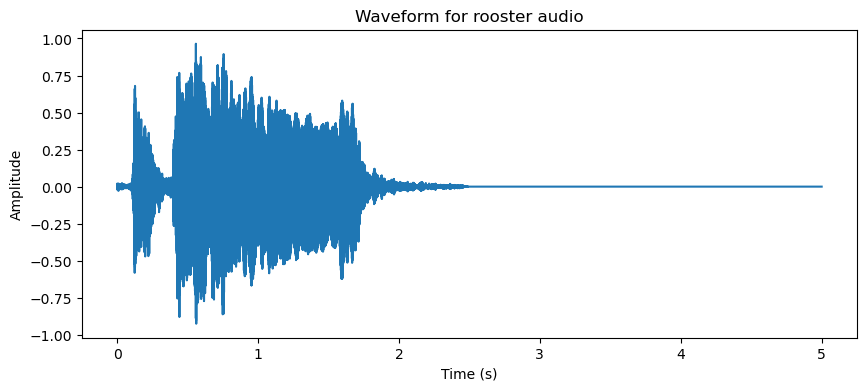

Plotting waveform for audio with label: sea_waves


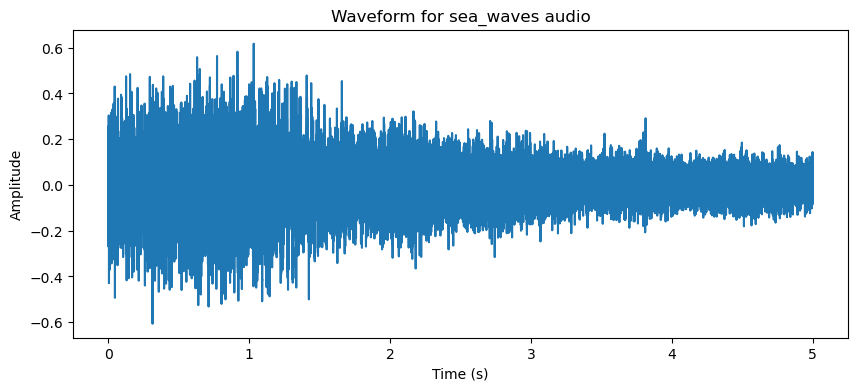

Plotting waveform for audio with label: siren


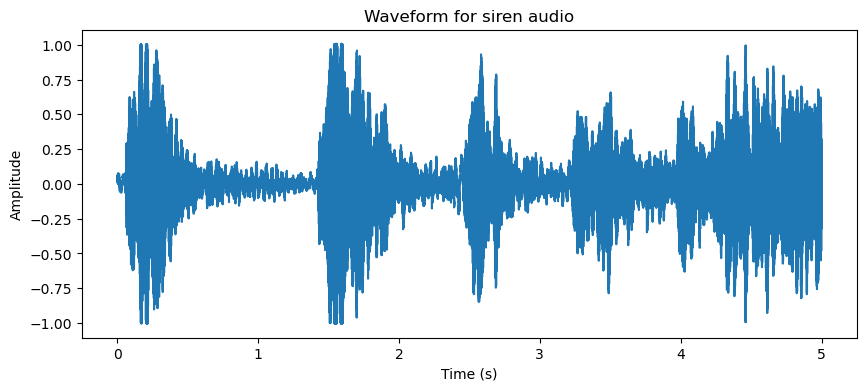

Plotting waveform for audio with label: cat


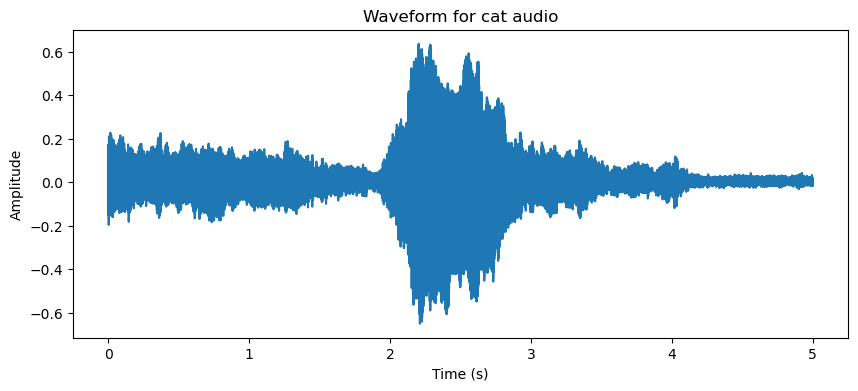

Plotting waveform for audio with label: door_wood_creaks


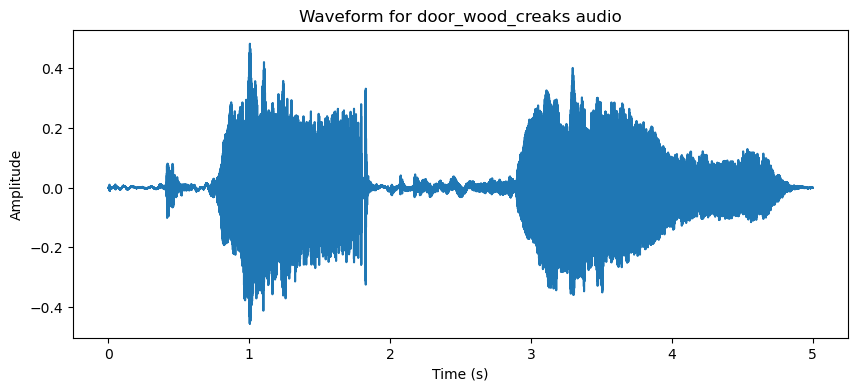

Plotting waveform for audio with label: crickets


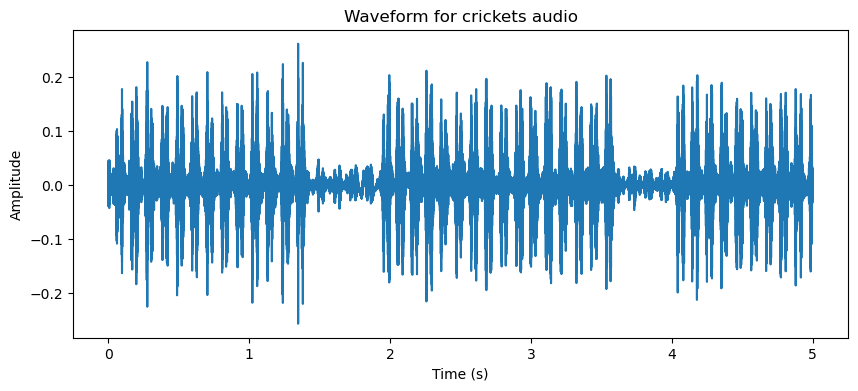

In [62]:
import librosa
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have the 'files' dictionary containing paths to audio files
for label, path in files.items():
    print(f"Plotting waveform for audio with label: {label}")
    
    # Load the audio file
    audio, sr = librosa.load(path)
    
    # Calculate time array
    time = np.arange(0, len(audio)) / sr
    
    # Plot the waveform
    plt.figure(figsize=(10, 4))
    plt.plot(time, audio)
    plt.title(f"Waveform for {label} audio")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.show()


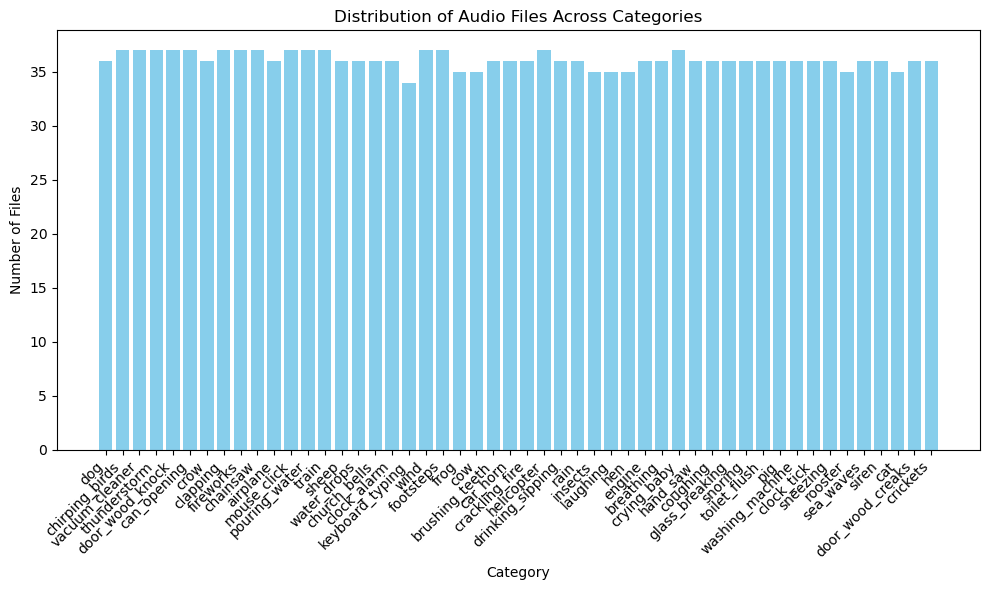

In [52]:
import matplotlib.pyplot as plt

# Count the number of files in each category
category_counts = {label: len(files[label]) for label in files}

# Plot the distribution
plt.figure(figsize=(10, 6))
plt.bar(category_counts.keys(), category_counts.values(), color='skyblue')
plt.xlabel('Category')
plt.ylabel('Number of Files')
plt.title('Distribution of Audio Files Across Categories')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [53]:
import librosa
import numpy as np
import soundfile as sf

def stretch(data, rate=0.99):
    stretched_data = librosa.effects.time_stretch(data, rate=rate)
    # Pad or trim to match the length of the original audio
    if len(stretched_data) < len(data):
        pad_length = len(data) - len(stretched_data)
        stretched_data = np.pad(stretched_data, (0, pad_length), mode='constant')
    elif len(stretched_data) > len(data):
        stretched_data = stretched_data[:len(data)]
    return stretched_data

def resample(data, target_sr):
    return librosa.resample(data, orig_sr=sample_rate, target_sr=target_sr)

def pitch_shift(data, steps=1):
    return librosa.effects.pitch_shift(data, sr=sample_rate, n_steps=steps)

def time_shift(data, shift_ms=100):
    shift_samples = int((shift_ms * sample_rate) / 1000)
    return np.roll(data, shift_samples)

# Example usage:
test_file = ground_location + 'audio/'
# Load audio file
audio, sample_rate = librosa.load(test_file + '1-4211-A-12.wav', sr=None)

# Augmentation: stretch
stretched_audio = stretch(audio, rate=0.99)  # Adjust rate as needed
sf.write('stretched_audio.wav', stretched_audio, sample_rate)

# Augmentation: pitch shift TOTO: MAKE THIS 1 OR LESS, LARGER THAN THAT MIGHT BE TOO AGRESSIVE
pitch_shifted_audio = pitch_shift(audio, steps=1)  # Adjust steps as needed
sf.write('pitch_shifted_audio.wav', pitch_shifted_audio, sample_rate)

# Augmentation: time shift
time_shifted_audio = time_shift(audio, shift_ms=100)  # Adjust shift_ms as needed
sf.write('time_shifted_audio.wav', time_shifted_audio, sample_rate)

# Augmentation: resample TODO: 16000 to 48000hz:  22050,16384 Hz, 16000 Hz, .22050 Hz, 44100 Hz, 48000 Hz
resampled_audio = resample(audio, target_sr=48000)  # Adjust target sampling rate as needed
sf.write('resampled_audio.wav', resampled_audio, 48000)  # Specify the new sampling rate


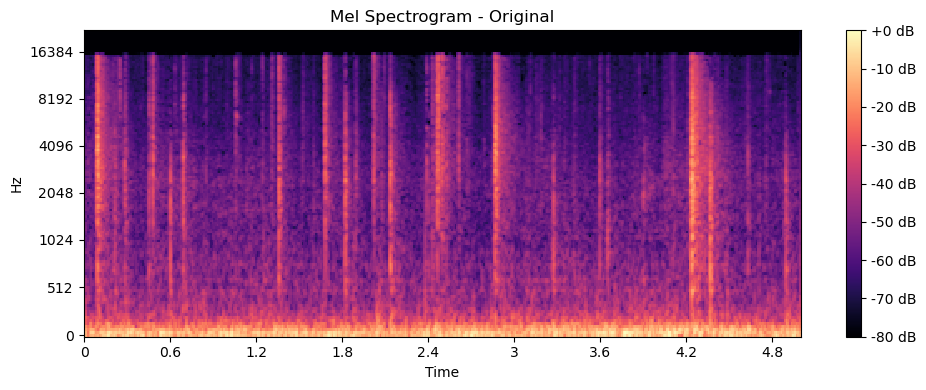

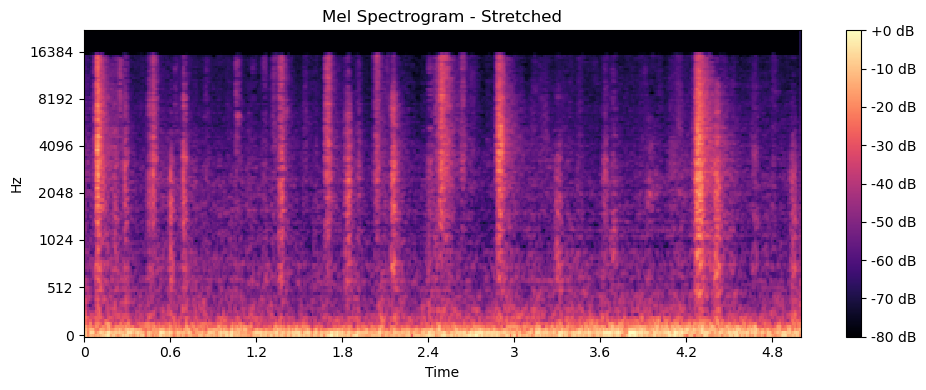

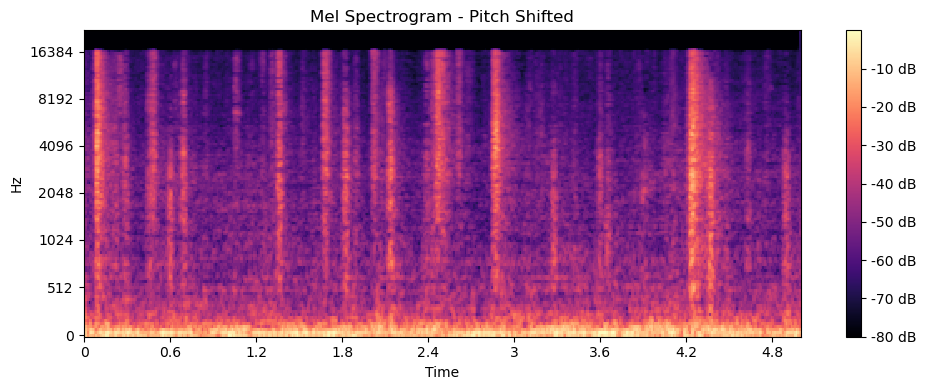

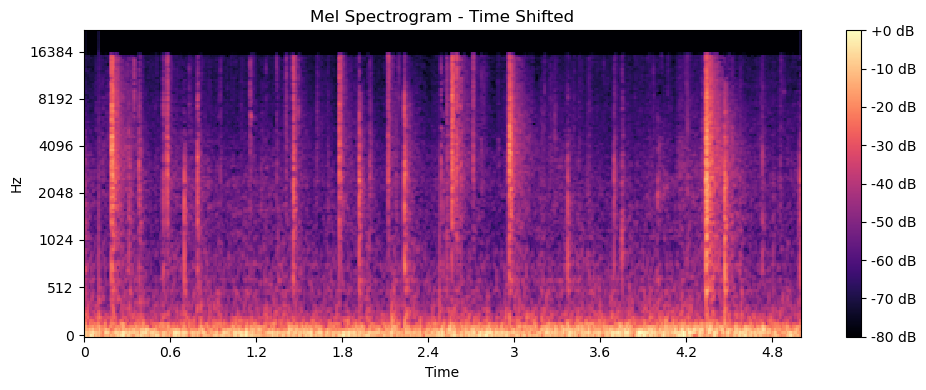

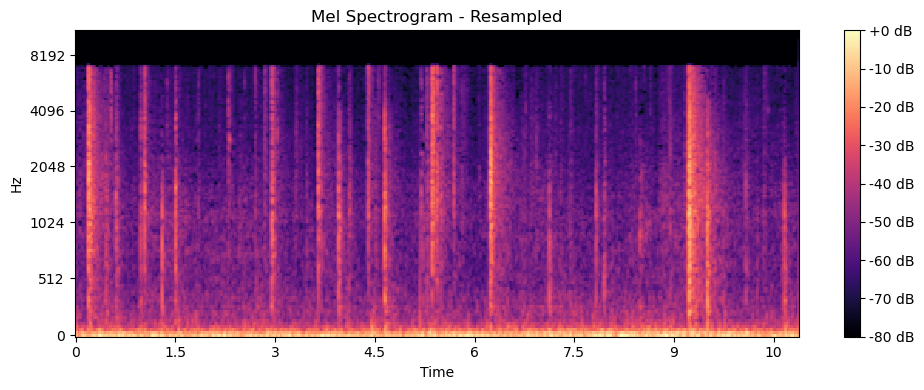

In [54]:
# Plot Mel spectrogram for the original audio
plt.figure(figsize=(10, 4))
mel_spec_original = librosa.feature.melspectrogram(y=audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_original, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Original')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the stretched audio
plt.figure(figsize=(10, 4))
mel_spec_stretched = librosa.feature.melspectrogram(y=stretched_audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_stretched, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Stretched')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the pitch shifted audio
plt.figure(figsize=(10, 4))
mel_spec_pitch_shifted = librosa.feature.melspectrogram(y=pitch_shifted_audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_pitch_shifted, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Pitch Shifted')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the time shifted audio
plt.figure(figsize=(10, 4))
mel_spec_time_shifted = librosa.feature.melspectrogram(y=time_shifted_audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_time_shifted, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Time Shifted')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the resampled audio
plt.figure(figsize=(10, 4))
mel_spec_resampled = librosa.feature.melspectrogram(y=resampled_audio, sr=22050)
librosa.display.specshow(librosa.power_to_db(mel_spec_resampled, ref=np.max), y_axis='mel', x_axis='time', sr=22050)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Resampled')
plt.tight_layout()
plt.show()

In [55]:
from IPython.display import Audio, display

# Assuming you have your audio data in variables: audio, stretched_audio, sample_rate

# Play original audio
print("Original Audio:")
display(Audio(data=audio, rate=sample_rate))

# Play stretched audio
print("Stretched Audio:")
display(Audio(data=stretched_audio, rate=sample_rate))
# Play pitch shifted audio
print("pitch shift Audio:")
display(Audio(data=pitch_shifted_audio, rate=sample_rate))

# Play time shifted audio
print("time shift Audio:")
display(Audio(data=time_shifted_audio, rate=sample_rate))
# Play resample shifted audio
print("resample shift Audio:")
display(Audio(data=resampled_audio, rate=sample_rate))


Original Audio:


Stretched Audio:


pitch shift Audio:


time shift Audio:


resample shift Audio:


In [56]:
import librosa
import numpy as np
import soundfile as sf

def stretch(data, rate=0.99):
    stretched_data = librosa.effects.time_stretch(data, rate=rate)
    # Pad or trim to match the length of the original audio
    if len(stretched_data) < len(data):
        pad_length = len(data) - len(stretched_data)
        stretched_data = np.pad(stretched_data, (0, pad_length), mode='constant')
    elif len(stretched_data) > len(data):
        stretched_data = stretched_data[:len(data)]
    return stretched_data

def resample(data, target_sr):
    return librosa.resample(data, orig_sr=sample_rate, target_sr=target_sr)

def pitch_shift(data, steps=1):
    return librosa.effects.pitch_shift(data, sr=sample_rate, n_steps=steps)

def time_shift(data, shift_ms=100):
    shift_samples = int((shift_ms * sample_rate) / 1000)
    return np.roll(data, shift_samples)

def amplitude_scale(data, scale_factor=0.5):
    return data * scale_factor

# Example usage:
test_file = ground_location + 'audio/'
# Load audio file
audio, sample_rate = librosa.load(test_file + '1-103298-A-9.wav', sr=None)

# Augmentation: stretch
stretched_audio = stretch(audio, rate=0.99)  # Adjust rate as needed
sf.write('stretched_audio.wav', stretched_audio, sample_rate)

# Augmentation: pitch shift (Make sure steps <= 1 to avoid aggressive pitch shifts)
pitch_shifted_audio = pitch_shift(audio, steps=1)  # Adjust steps as needed
sf.write('pitch_shifted_audio.wav', pitch_shifted_audio, sample_rate)

# Augmentation: time shift
time_shifted_audio = time_shift(audio, shift_ms=100)  # Adjust shift_ms as needed
sf.write('time_shifted_audio.wav', time_shifted_audio, sample_rate)

# Augmentation: resample (Adjust target_sr as needed)
resampled_audio = resample(audio, target_sr=16000)  # Adjust target sampling rate as needed
sf.write('resampled_audio.wav', resampled_audio, 16000)  # Specify the new sampling rate

# Augmentation: amplitude scaling (Adjust scale_factor as needed)
scaled_audio = amplitude_scale(audio, scale_factor=0.5)  # Adjust scale_factor as needed
sf.write('scaled_audio.wav', scaled_audio, sample_rate)


In [57]:

# Print the sample rate
print("Sample Rate:", sample_rate)

Sample Rate: 44100


In [58]:
print("resample shift Audio:")
display(Audio(data=resampled_audio, rate=sample_rate))

resample shift Audio:


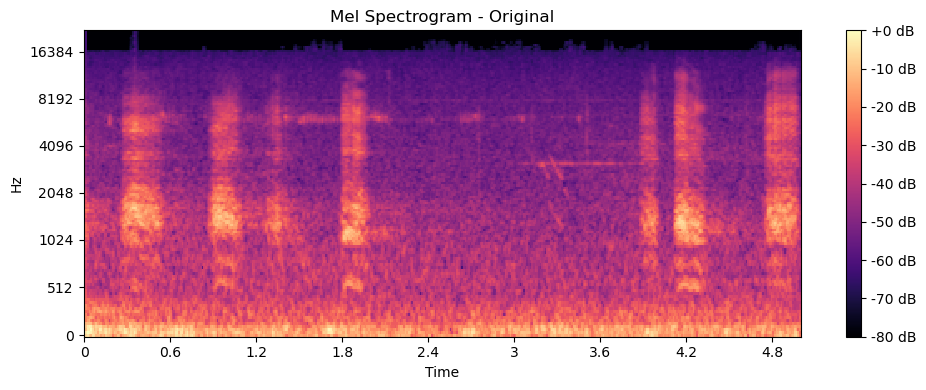

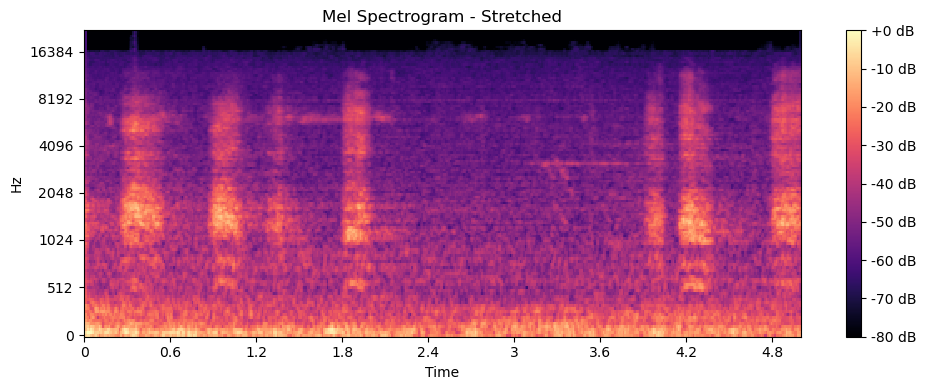

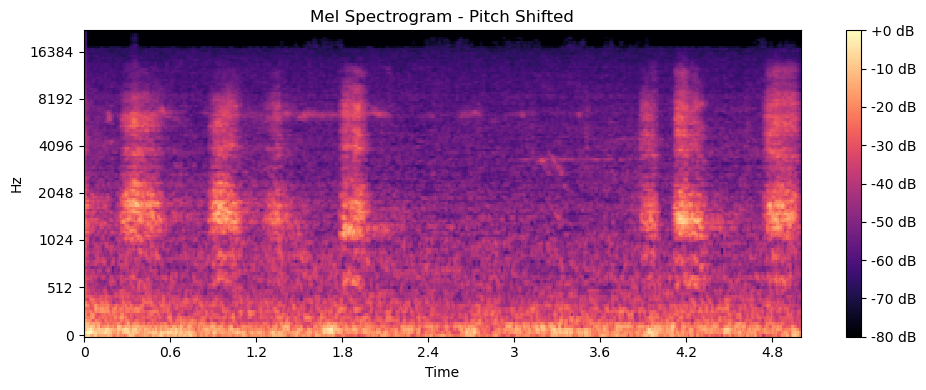

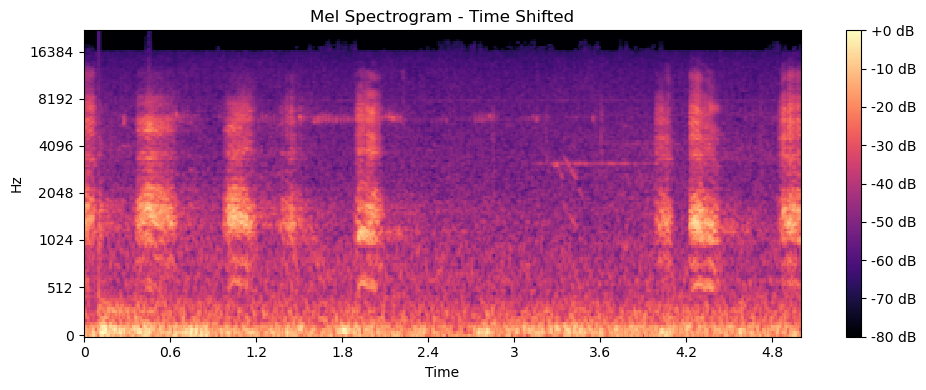

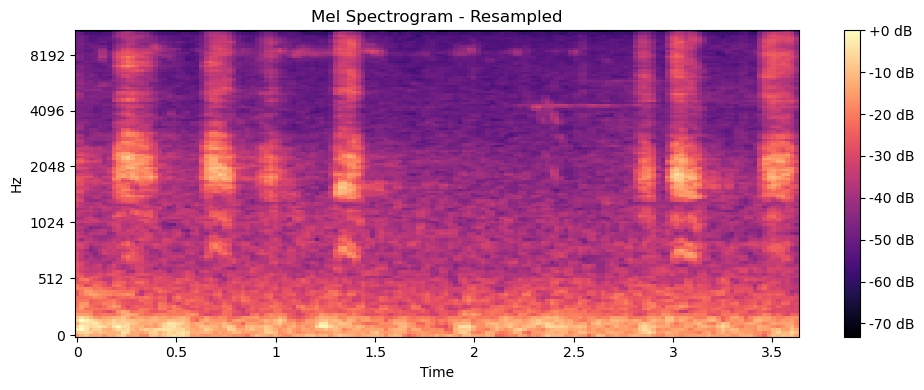

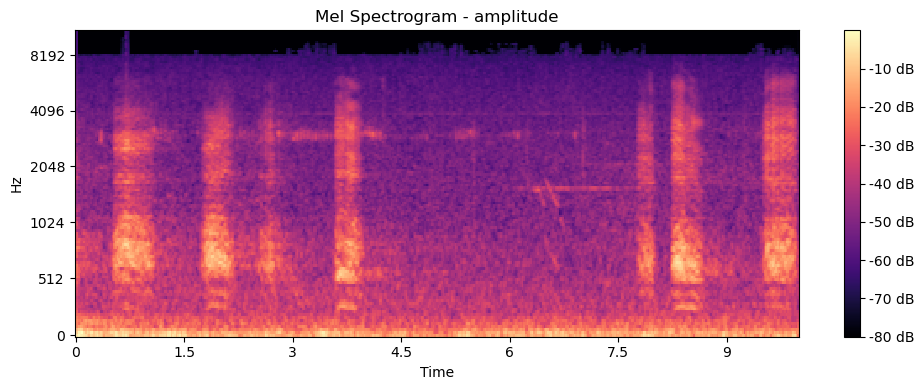

In [59]:
# Plot Mel spectrogram for the original audio
plt.figure(figsize=(10, 4))
mel_spec_original = librosa.feature.melspectrogram(y=audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_original, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Original')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the stretched audio
plt.figure(figsize=(10, 4))
mel_spec_stretched = librosa.feature.melspectrogram(y=stretched_audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_stretched, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Stretched')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the pitch shifted audio
plt.figure(figsize=(10, 4))
mel_spec_pitch_shifted = librosa.feature.melspectrogram(y=pitch_shifted_audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_pitch_shifted, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Pitch Shifted')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the time shifted audio
plt.figure(figsize=(10, 4))
mel_spec_time_shifted = librosa.feature.melspectrogram(y=time_shifted_audio, sr=sample_rate)
librosa.display.specshow(librosa.power_to_db(mel_spec_time_shifted, ref=np.max), y_axis='mel', x_axis='time', sr=sample_rate)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Time Shifted')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the resampled audio
plt.figure(figsize=(10, 4))
mel_spec_resampled = librosa.feature.melspectrogram(y=resampled_audio, sr=22050)
librosa.display.specshow(librosa.power_to_db(mel_spec_resampled, ref=np.max), y_axis='mel', x_axis='time', sr=22050)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - Resampled')
plt.tight_layout()
plt.show()

# Plot Mel spectrogram for the aplitude audio
plt.figure(figsize=(10, 4))
mel_spec_amplitude = librosa.feature.melspectrogram(y=scaled_audio, sr=22050)
librosa.display.specshow(librosa.power_to_db(mel_spec_amplitude, ref=np.max), y_axis='mel', x_axis='time', sr=22050)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram - amplitude')
plt.tight_layout()
plt.show()

Good range tested:

def stretch:  rate=0.99
    stretched_data = librosa.effects.time_stretch(data, rate=rate)
    # Pad or trim to match the length of the original audio
    if len(stretched_data) < len(data):
        pad_length = len(data) - len(stretched_data)
        stretched_data = np.pad(stretched_data, (0, pad_length), mode='constant')
    elif len(stretched_data) > len(data):
        stretched_data = stretched_data[:len(data)]
    return stretched_data

def resample, between:  16000 to 48000hz. 
def pitch_shift: steps<=1
   

def time_shift: <=80ms

def amplitude_scale:  scale_factor<=0.5
    return data * scale_factor


In [60]:
from IPython.display import Audio, display

# Assuming you have your audio data in variables: audio, stretched_audio, sample_rate

# Play original audio
print("Original Audio:")
display(Audio(data=audio, rate=sample_rate))

# Play stretched audio
print("Stretched Audio:")
display(Audio(data=stretched_audio, rate=sample_rate))
# Play pitch shifted audio
print("pitch shift Audio:")
display(Audio(data=pitch_shifted_audio, rate=sample_rate))

# Play time shifted audio
print("time shift Audio:")
display(Audio(data=time_shifted_audio, rate=sample_rate))
# Play resample shifted audio
print("resample shift Audio:")
display(Audio(data=resampled_audio, rate=sample_rate))

# Play amplitude shifted audio
print("amplitude shift Audio:")
display(Audio(data=scaled_audio, rate=sample_rate))

Original Audio:


Stretched Audio:


pitch shift Audio:


time shift Audio:


resample shift Audio:


amplitude shift Audio:


AUGMENTED THE ENTIRE .WAVE FOLDER

In [ ]:
COMMENT OUT  THIS LINE TO RUN IF AUGMENTED FILES ARE NOT YET LARGE ENOUGH.
NOTE: 'if run on large enough resource than just set for _ in range(i); in which i is the number of augmented images/file, 
'and change:  output_path = os.path.join(output_folder, f"{os.path.splitext(filename)[0]}_{selected_method}_{13}.png");-> the 13 can be replaced with _.
'when not enough memory: then manualy assigned_13 and i to: 0, 1,2... to avoid interupt and duplication in file.

import librosa
import numpy as np
from PIL import Image
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import cv2

# Define augmentation functions
def stretch(data, rate=0.99):
    stretched_data = librosa.effects.time_stretch(data, rate=rate)
    return stretched_data[:len(data)] if len(stretched_data) > len(data) else np.pad(stretched_data, (0, len(data) - len(stretched_data)), mode='constant')
# Resample function
def resample(data, target_sr):
    return librosa.resample(data, orig_sr=sample_rate, target_sr=target_sr)
# Pitch shift function
def pitch_shift(data, steps=0):
    return librosa.effects.pitch_shift(data, sr=sample_rate, n_steps=steps)
# Time shift function
def time_shift(data, shift_ms=0):
    shift_samples = int((shift_ms * sample_rate) / 1000)
    return np.roll(data, shift_samples)
# scale amplitude function
def amplitude_scale(data, scale_factor=0):
    return data * scale_factor

# Define function to convert audio to mel-spectrogram
def audio_to_mel_spectrogram(audio, sample_rate):
    mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sample_rate)
    return librosa.power_to_db(mel_spectrogram, ref=np.max)

# Define function to save mel-spectrogram as image with resizing
def save_mel_spectrogram_image(mel_spectrogram, output_path, target_size=(64, 64)):
    plt.figure(figsize=(10, 6))
    librosa.display.specshow(mel_spectrogram, sr=sample_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel Spectrogram')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.tight_layout()
    plt.savefig(output_path)
    plt.close()

def save_mel(mel_spectrogram, output_path, target_size=(64, 64)):
    fig, ax = plt.subplots(figsize=(10, 6))
    librosa.display.specshow(mel_spectrogram, sr=sample_rate, x_axis='time', y_axis='mel', ax=ax)
    plt.colorbar(ax.collections[0], ax=ax).remove()
    plt.title('Mel Spectrogram')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.tight_layout()
    fig.canvas.draw()
    plot_array = np.array(fig.canvas.renderer.buffer_rgba())
    plt.close(fig)
    resized_array = cv2.resize(plot_array, target_size)
    cv2.imwrite(output_path, resized_array)

# Define augmentation parameters
sample_rate = 44100
audio_folder = ground_location + 'audio/'
output_folder = ground_location + 'mel_augmented'
os.makedirs(output_folder, exist_ok=True)

# Preload augmentation parameters
resample_rates = [16000, 22050, 32000, 44100, 48000]
pitch_shift_steps = np.linspace(0, 0.2, num=5)
time_shift_ms_vals = np.linspace(0, 80, num=15)

# Load original audio files and perform augmentation
for filename in os.listdir(audio_folder):
    if filename.endswith(".wav"):
        file_path = os.path.join(audio_folder, filename)
        audio, _ = librosa.load(file_path, sr=sample_rate)
        
        # Generate and save mel-spectrograms
        for _ in range(1):  # Generate 20 images per audio file
            selected_method = np.random.choice(['stretch', 'resample', 'pitch_shift', 'time_shift', 'amplitude_scale'])
            augmented_audio = audio.copy()  # Make a copy of original audio for each augmentation
            
            if selected_method == 'stretch':
                augmented_audio = stretch(augmented_audio)
            elif selected_method == 'resample':
                augmented_audio = resample(augmented_audio, target_sr=np.random.choice(resample_rates))
            elif selected_method == 'pitch_shift':
                augmented_audio = pitch_shift(augmented_audio, steps=np.random.choice(pitch_shift_steps))
            elif selected_method == 'time_shift':
                augmented_audio = time_shift(augmented_audio, shift_ms=np.random.choice(time_shift_ms_vals))
            elif selected_method == 'amplitude_scale':
                scale_factor = np.random.uniform(0.5, 1.5)
                if scale_factor < 1.0:
                    scale_factor = np.random.uniform(1.0, 1.5)
                elif scale_factor > 1.0:
                    scale_factor = np.random.uniform(0.5, 1.0)
                augmented_audio = amplitude_scale(augmented_audio, scale_factor=scale_factor)
                
            # Convert to mel using mel function
            mel_spectrogram = audio_to_mel_spectrogram(augmented_audio, sample_rate)
            #Save the images
            output_path = os.path.join(output_folder, f"{os.path.splitext(filename)[0]}_{selected_method}_{13}.png")
            save_mel(mel_spectrogram, output_path)



In [ ]:
COMMENT OUT THIS LINE TO RUN IF ORIGINAL HAS NO SPECTOGRAM IMAGES

import os
import librosa
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Define function to convert audio to mel-spectrogram
def audio_to_mel_spectrogram(audio, sample_rate):
    mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sample_rate)
    return librosa.power_to_db(mel_spectrogram, ref=np.max)

def save_mel_spectrogram_image(mel_spectrogram, output_path, target_size=(64, 64)):
    plt.figure(figsize=(10, 6))
    librosa.display.specshow(mel_spectrogram, sr=sample_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB').remove()  # Remove the color bar
    plt.title('Mel Spectrogram')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.tight_layout()
    plt.savefig(output_path)
    plt.close()

def save_mel_spectrogram_image(mel_spectrogram, output_path, target_size=(64, 64)):
    plt.figure(figsize=(10, 6))
    librosa.display.specshow(mel_spectrogram, sr=sample_rate, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB').remove()  # Remove the color bar
    plt.title('Mel Spectrogram')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.tight_layout()

    # Get the current figure and resize it to the target size
    fig = plt.gcf()
    fig.canvas.draw()
    plot_array = np.array(fig.canvas.renderer.buffer_rgba())
    plt.close()

    resized_array = cv2.resize(plot_array, target_size)
    cv2.imwrite(output_path, resized_array)

# Define augmentation parameters
sample_rate = 44100
audio_folder = ground_location + 'audio/'
output_folder = ground_location + 'mel_augmented'

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Iterate through audio folder
for filename in os.listdir(audio_folder):
    if filename.endswith(".wav"):
        file_path = os.path.join(audio_folder, filename)
        audio, _ = librosa.load(file_path, sr=sample_rate)
        
        # Convert audio to mel-spectrogram
        mel_spectrogram = audio_to_mel_spectrogram(audio, sample_rate)
        
        # Save mel-spectrogram as image
        output_path = os.path.join(output_folder, f"{os.path.splitext(filename)[0]}.png")
        save_mel_spectrogram_image(mel_spectrogram, output_path)


In [24]:
import random
from sklearn.model_selection import train_test_split
import cv2

# Function to load and preprocess an image
def load_image(image_path, target_size=(64, 64)):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, target_size)  # Resize image
    image = image.astype(np.float32) / 255.0  # Normalize pixel values to [0, 1]
    return image

# Path to the directory containing the images
image_directory = ground_location + 'mel_augmented/'

# Get the list of image filenames in the output_images folder
image_filenames = os.listdir(image_directory)

# Shuffle the list of image filenames
random.shuffle(image_filenames)

# Split the shuffled filenames into train, validation, and test sets (70% train, 20% validation, 10% test)
X_train_filenames, X_temp_filenames = train_test_split(image_filenames, test_size=0.3, random_state=42)
X_val_filenames, X_test_filenames = train_test_split(X_temp_filenames, test_size=1/3, random_state=42)

# Load images into NumPy arrays
X_train = np.array([load_image(os.path.join(image_directory, filename)) for filename in X_train_filenames])
X_val = np.array([load_image(os.path.join(image_directory, filename)) for filename in X_val_filenames])
X_test = np.array([load_image(os.path.join(image_directory, filename)) for filename in X_test_filenames])

# Print the summary of shapes
print("Train shape:", X_train.shape, len(X_train_filenames))
print("Test shape:", X_test.shape, len(X_test_filenames))
print("Val shape:", X_val.shape, len(X_val_filenames))

Train shape: (24220, 64, 64, 3) 24220
Test shape: (3460, 64, 64, 3) 3460
Val shape: (6920, 64, 64, 3) 6920


In [25]:
import os

# Define function to extract the base filename
def extract_base_filename(filename):
    return os.path.splitext(os.path.basename(filename))[0].split('_')[0]

# Initialize empty lists to store labels
y_train = []
y_test = []
y_val = []

# Iterate through the filenames in X_train_filenames, X_test_filenames, and X_val_filenames
for X_filenames, y_list in zip([X_train_filenames, X_test_filenames, X_val_filenames], [y_train, y_test, y_val]):
    for filename in X_filenames:
        base_filename = extract_base_filename(filename)
        
        # Search for the base filename in the DataFrame df
        matching_rows = df[df['filename'].str.contains(base_filename)]
        
        # If a match is found, extract the label and add it to the respective y_ list
        if not matching_rows.empty:
            label = matching_rows['category'].iloc[0]
            y_list.append(label)
        else:
            print(f"No corresponding label found for filename: {filename}")

# Print the size of each label set
print("Size of y_train:", len(y_train))
print("Size of y_val:", len(y_val))
print("Size of y_test:", len(y_test))


Size of y_train: 24220
Size of y_val: 6920
Size of y_test: 3460


In [26]:
# Define the list of categories
categories = ['airplane', 'breathing', 'brushing_teeth', 'can_opening', 'car_horn', 'cat',
              'chainsaw', 'chirping_birds', 'church_bells', 'clapping', 'clock_alarm',
              'clock_tick', 'coughing', 'cow', 'crackling_fire', 'crickets', 'crow',
              'crying_baby', 'dog', 'door_wood_creaks', 'door_wood_knock',
              'drinking_sipping', 'engine', 'fireworks', 'footsteps', 'frog',
              'glass_breaking', 'hand_saw', 'helicopter', 'hen', 'insects',
              'keyboard_typing', 'laughing', 'mouse_click', 'pig', 'pouring_water', 'rain',
              'rooster', 'sea_waves', 'sheep', 'siren', 'sneezing', 'snoring', 'thunderstorm',
              'toilet_flush', 'train', 'vacuum_cleaner', 'washing_machine', 'water_drops',
              'wind']

# Create a mapping dictionary from categories to integers
category_to_integer = {category: idx for idx, category in enumerate(categories)}

# Convert y labels to integers
y_train = [category_to_integer[category] for category in y_train]
y_test = [category_to_integer[category] for category in y_test]
y_val = [category_to_integer[category] for category in y_val]
# y_ need to be in numpy array also
y_train = np.array(y_train)
y_test=np.array(y_test)
y_val=np.array(y_val)

# Print the size of each label set
print("Size of y_train:", len(y_train))
print("Size of y_val:", len(y_val))
print("Size of y_test:", len(y_test))


Size of y_train: 24220
Size of y_val: 6920
Size of y_test: 3460


In [27]:
print(type(X_train))
print(type(y_train))


<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


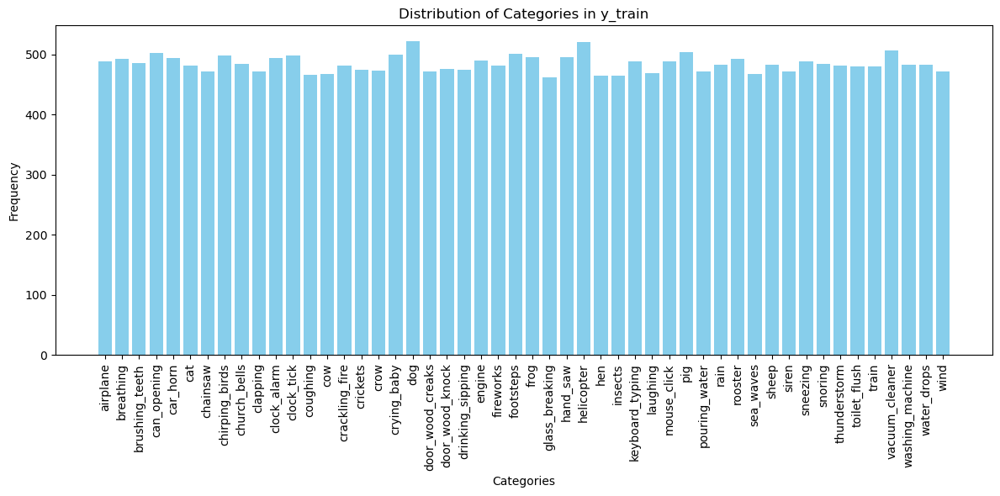

In [28]:
#Just checking for to see if the dataset is balanced
# Count the occurrences of each category in y_train
unique_categories, category_counts = np.unique(y_train, return_counts=True)

# Create a bar plot
plt.figure(figsize=(12, 6))
plt.bar(unique_categories, category_counts, color='skyblue')
plt.xlabel('Categories')
plt.ylabel('Frequency')
plt.title('Distribution of Categories in y_train')
plt.xticks(ticks=unique_categories, labels=categories, rotation=90)  # Set x-axis labels
plt.tight_layout()
plt.show()


In [28]:
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_val shape:", X_val.shape)
print("y_val shape:", y_val.shape)


X_train shape: (24220, 64, 64, 3)
y_train shape: (24220,)
X_val shape: (6920, 64, 64, 3)
y_val shape: (6920,)


In [30]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Load the pre-trained ResNet152V2 model without the top (classification) layer
base_model = ResNet152V2(weights='imagenet', include_top=False, input_shape=(64, 64, 3))

# Freeze the base model layers so that they are not trainable
for layer in base_model.layers:
    layer.trainable = False

# Add classification layers on top of the base model
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(len(categories), activation='softmax')  # Output layer with softmax activation
])

# Compile the model
model.compile(optimizer=Adam(),
              loss=SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

# Print the model summary
model.summary()

# Define your callbacks
checkpoint_callback = ModelCheckpoint(
    filepath='best_model.keras',  # Adjusted filepath to end with .keras extension
    monitor='val_loss',           # Monitor validation loss for saving the best model
    save_best_only=True,          # Save only the best model
    verbose=1                     # Verbosity mode (1: print messages)
)


# Define your learning rate callback function
def get_lr_callback(batch_size=32):
    lr_start   = 0.005
    lr_max     = 0.000125 * batch_size
    lr_min     = 0.000001
    lr_ramp_ep = 5
    lr_sus_ep  = 0
    lr_decay   = 0.8
   
    def lrfn(epoch):
        if epoch < lr_ramp_ep:
            lr = (lr_max - lr_start) / lr_ramp_ep * epoch + lr_start
        elif epoch < lr_ramp_ep + lr_sus_ep:
            lr = lr_max
        else:
            lr = (lr_max - lr_min) * lr_decay**(epoch - lr_ramp_ep - lr_sus_ep) + lr_min
        return lr

    lr_callback = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=False)
    return lr_callback

# Define your early stopping callback
early_stopping_callback = EarlyStopping(
    monitor='val_loss',  # Monitor validation loss for early stopping
    patience=10,          # Number of epochs with no improvement after which training will be stopped
    verbose=1             # Verbosity mode (1: print messages)
)

# Train the model with callbacks
history = model.fit(X_train, y_train,
                    epochs=50,               # Number of epochs for training
                    batch_size=32,           # Batch size
                    validation_data=(X_val, y_val),  # Validation data
                    callbacks=[checkpoint_callback, get_lr_callback(), early_stopping_callback])  # Callbacks


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet152v2 (Functional)        │ ?                      │    58,331,648 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ ?                      │   0 (unbuilt) │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ ?                      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 58,331,648 (222.52 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 58,331,648 (222.52 MB)

Epoch 1/50
757/757 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - accuracy: 0.3088 - loss: 2.7579
Epoch 1: val_loss improved from inf to 1.15857, saving model to best_model.keras
757/757 ━━━━━━━━━━━━━━━━━━━━ 223s 267ms/step - accuracy: 0.3089 - loss: 2.7573 - val_accuracy: 0.6624 - val_loss: 1.1586 - learning_rate: 0.0050
Epoch 2/50
757/757 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step - accuracy: 0.5310 - loss: 1.6384
Epoch 2: val_loss improved from 1.15857 to 0.79518, saving model to best_model.keras
757/757 ━━━━━━━━━━━━━━━━━━━━ 190s 251ms/step - accuracy: 0.5310 - loss: 1.6383 - val_accuracy: 0.7743 - val_loss: 0.7952 - learning_rate: 0.0048
Epoch 3/50
757/757 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step - accuracy: 0.6208 - loss: 1.2795
Epoch 3: val_loss improved from 0.79518 to 0.64105, saving model to best_model.keras
757/757 ━━━━━━━━━━━━━━━━━━━━ 195s 257ms/step - accuracy: 0.6208 - loss: 1.2795 - val_accuracy: 0.8166 - val_loss: 0.6410 - learning_rate: 0.0046
Epoch 4/50
757/757 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/s

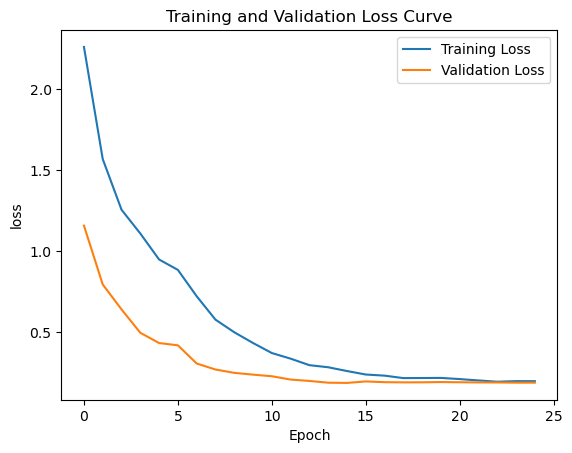

In [31]:
#extract loss values
training_loss = history.history['loss']
validation_loss = history.history['val_loss']
#plotting
plt.plot(training_loss, label='Training Loss')
plt.plot(validation_loss, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('loss')
plt.title('Training and Validation Loss Curve')
plt.legend()
plt.show()

In [34]:
y_pred = model.predict(X_test)

109/109 ━━━━━━━━━━━━━━━━━━━━ 55s 463ms/step


In [64]:
import numpy as np
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score

# Convert predicted probabilities to class labels
y_pred_classes = np.argmax(y_pred, axis=1)

# Ensure the lengths of y_test and y_pred_classes are consistent
assert len(y_test) == len(y_pred_classes), "Number of samples in y_test and y_pred_classes must be the same"

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred_classes)

# Calculate F1 score
f1 = f1_score(y_test, y_pred_classes, average='weighted')

# Calculate precision
precision = precision_score(y_test, y_pred_classes, average='weighted')

# Calculate recall
recall = recall_score(y_test, y_pred_classes, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)
print("Precision:", precision)
print("Recall:", recall)


Accuracy: 0.9618497109826589
F1 Score: 0.9618659045118805
Precision: 0.9623252393958504
Recall: 0.9618497109826589


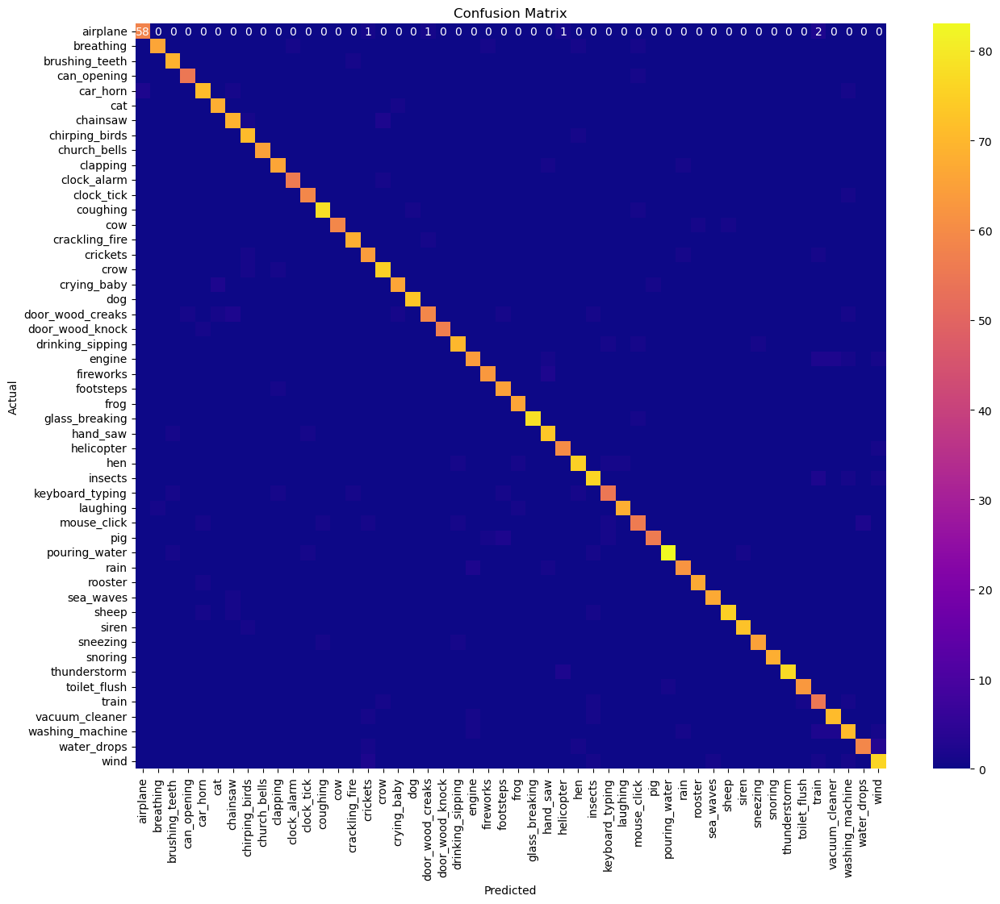

In [65]:
# Convert predicted probabilities to class labels
#y_pred_classes = np.argmax(y_pred, axis=1)

# Ensure the lengths of y_test and y_pred_classes are consistent
#assert len(y_test) == len(y_pred_classes), "Number of samples in y_test and y_pred_classes must be the same"

# Plot confusion matrix
cm = confusion_matrix(y_test, y_pred_classes)
plt.figure(figsize=(15, 12))
sns.heatmap(cm, annot=True, fmt=".3g", cmap="plasma", xticklabels=categories, yticklabels=categories)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()